<h3><a href="#BasketAnalysis" style="text-decoration: none;">Basket Analysis</a></h3>

<div>
  <h3><a href="#ImportingLibraries" style="text-decoration: none;">0. Executive Summary</a></h3>

  <h3><a href="#ImportingLibraries" style="text-decoration: none;">1. Importing all Libraries</a></h3>
  
  <h3><a href="#LoadingPreprocessing" style="text-decoration: none;">2. Loading the Dataset and Preprocessing</a></h3>
  
  <h3><a href="#CustomerAnalysis" style="text-decoration: none;">3. Analysis of customers</a></h3>
  <ul style="font-size: 18px;">
    <li><a href="#Overview" style="text-decoration: none;">3.1 Overview</a></li>
    <li><a href="#HighRevenueClients" style="text-decoration: none;">3.2 Identifying clients purchasing few products but represent high revenue</a></li>
    <li><a href="#BigClients" style="text-decoration: none;">3.3 Looking into Big Clients</a></li>
    <li><a href="#CategorizingClients" style="text-decoration: none;">3.4 Categorizing clients based on: products & branches</a></li>
    <li><a href="#RFM" style="text-decoration: none;">3.5 Adding RFM</a></li>
  </ul>
  
  <h3><a href="#BranchesAnalysis" style="text-decoration: none;">4. Branches Analysis</a></h3>
  
  <h3><a href="#ProductsBranchesRelation" style="text-decoration: none;">5. Relation Between Products & Branches</a></h3>
  
  <h3><a href="#BasketAnalysis" style="text-decoration: none;">6. Basket Analysis</a></h3>
</div>


# 0. Executive Summary

#### Objective:
The objective of the Basket Analysis notebook is likely to understand customer purchasing patterns by analyzing transaction data with different products. Therefore, our model helps in identifying products that are frequently bought together, which can inform cross-selling strategies, promotional offers, and inventory management.

#### Methodology:
The methodology to conduct the basket analysis includes data cleaning, transaction grouping, and the application of association rule learning algorithms: Apriori to identify frequent itemsets and generate rules.

#### Key Findings:
Key findings would highlight the most common product combinations, the strength of associations between products, and possibly insights into customer segmentation based on purchasing behavior. This section includes metrics: support, confidence, and lift to quantify the strength of the rules identified.

Moreover, it is important to take into consideration the customers’ behavior in terms of purchasing preferences for further strategy recommendations. Firstly, with the analysis of the top products for 'Champions,' identified by their respective product IDs: 2681878, 463156, 539670, 932375, and 1180925; and for 'Potential Loyalists,' the following products IDs: 5399670, 932375, 1492103, 1180925, and 1438570 we can set strategies from our Basekt Analysis. Notably, some of these products overlap between the two segments.

#### Conclusions:
The insights of our Basket Analysis can guide strategic decisions in marketing, store layout optimization, and inventory management. Understanding product associations enables more effective cross-selling strategies, potentially enhancing customer satisfaction and sales performance.



# 1. Importing Libaries

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import numpy as np
import plotly.graph_objects as go
from scipy.stats import chi2_contingency

from mlxtend.frequent_patterns import apriori, association_rules

# 2. Loading the Dataset and Preprocessing

In [ ]:
file_path = '../transactions_dataset.csv'

original_df = pd.read_csv(file_path, sep=';')

In [ ]:
original_df.head()

,date_order,date_invoice,product_id,client_id,sales_net,quantity,order_channel,branch_id
0,2017-09-25,2017-09-25,2376333,188502,155.44320,3,online,2732
1,2017-09-25,2017-09-25,2520527,835089,16.39440,3,at the store,10279
2,2017-09-25,2017-09-25,2536756,1977896,365.76624,21,online,6184
3,2017-09-25,2017-09-25,3028673,598816,8.59878,201,at the store,4200
4,2017-09-25,2017-09-25,203377,2086861,1093.37400,3,by phone,7051


In [ ]:
file_path_4 = '../updated_transaction_dataset.csv'

data_aggregated = pd.read_csv(file_path_4, sep=',')

NameError: name 'pd' is not defined

In [ ]:
data_aggregated.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 63319315 entries, 0 to 63319314
Data columns (total 15 columns):
 #   Column             Dtype  
---  ------             -----  
 0   date_order         object 
 1   date_invoice       object 
 2   product_id         int64  
 3   client_id          int64  
 4   sales_net          float64
 5   quantity           int64  
 6   order_channel      object 
 7   branch_id          int64  
 8   cluster            int64  
 9   lead_time          float64
 10  price_category     object 
 11  quantity_category  object 
 12  Recency            int64  
 13  Frequency          int64  
 14  MonetaryValue      float64
dtypes: float64(3), int64(7), object(5)
memory usage: 7.1+ GB


In [ ]:
#Optimizing the dataset to reduce memory usage

# Convert integers
data_aggregated['product_id'] = data_aggregated['product_id'].astype(np.int32)
data_aggregated['client_id'] = data_aggregated['client_id'].astype(np.int32)
data_aggregated['quantity'] = data_aggregated['quantity'].astype(np.int32)
data_aggregated['branch_id'] = data_aggregated['branch_id'].astype(np.int16)
data_aggregated['cluster'] = data_aggregated['cluster'].astype(np.int16)
data_aggregated['Recency'] = data_aggregated['Recency'].astype(np.int32)
data_aggregated['Frequency'] = data_aggregated['Frequency'].astype(np.int32)

# Convert floating points
data_aggregated['sales_net'] = data_aggregated['sales_net'].astype(np.float32)
data_aggregated['lead_time'] = data_aggregated['lead_time'].astype(np.float32)
data_aggregated['MonetaryValue'] = data_aggregated['MonetaryValue'].astype(np.float32)

# Convert objects to categories where appropriate
data_aggregated['order_channel'] = data_aggregated['order_channel'].astype('category')
data_aggregated['price_category'] = data_aggregated['price_category'].astype('category')
data_aggregated['quantity_category'] = data_aggregated['quantity_category'].astype('category')

# Convert date strings to datetime
data_aggregated['date_order'] = pd.to_datetime(data_aggregated['date_order'], format='%Y-%m-%d')
data_aggregated['date_invoice'] = pd.to_datetime(data_aggregated['date_invoice'], format='%Y-%m-%d')

print(data_aggregated.info(memory_usage='deep'))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 63319315 entries, 0 to 63319314
Data columns (total 15 columns):
 #   Column             Dtype         
---  ------             -----         
 0   date_order         datetime64[ns]
 1   date_invoice       datetime64[ns]
 2   product_id         int32         
 3   client_id          int32         
 4   sales_net          float32       
 5   quantity           int32         
 6   order_channel      category      
 7   branch_id          int16         
 8   cluster            int16         
 9   lead_time          float32       
 10  price_category     category      
 11  quantity_category  category      
 12  Recency            int32         
 13  Frequency          int32         
 14  MonetaryValue      float32       
dtypes: category(3), datetime64[ns](2), float32(3), int16(2), int32(5)
memory usage: 3.2 GB
None


In [ ]:
file_path_2 = 'client_product_branch.csv'

client_df = pd.read_csv(file_path_2, sep=',')

In [ ]:
client_df.head()

,client_id,unique_product_ids,unique_branch_ids,total_sales_net,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7
0,417576,30812,537,"27,558,787",NaN,NaN,NaN,NaN
1,324012,10251,495,"9,700,475",NaN,NaN,NaN,NaN
2,1539945,2191,429,"973,882",NaN,NaN,NaN,NaN
3,511962,4346,427,"1,191,782",NaN,NaN,NaN,NaN
4,2201077,6884,305,"2,736,974",NaN,NaN,NaN,NaN


In [ ]:
#dropping extra columns
unnamed_cols = [col for col in client_df.columns if col.startswith('Unnamed')]

client_df = client_df.drop(columns=unnamed_cols)

client_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170589 entries, 0 to 170588
Data columns (total 4 columns):
 #   Column              Non-Null Count   Dtype 
---  ------              --------------   ----- 
 0   client_id           170589 non-null  int64 
 1   unique_product_ids  170589 non-null  int64 
 2   unique_branch_ids   170589 non-null  int64 
 3   total_sales_net     170589 non-null  object
dtypes: int64(3), object(1)
memory usage: 5.2+ MB


In [ ]:
client_df.head()

,client_id,unique_product_ids,unique_branch_ids,total_sales_net
0,417576,30812,537,"27,558,787"
1,324012,10251,495,"9,700,475"
2,1539945,2191,429,"973,882"
3,511962,4346,427,"1,191,782"
4,2201077,6884,305,"2,736,974"


In [ ]:
file_path_3 = 'branch_client_product.csv'

branche_df = pd.read_csv(file_path_3, sep=',')

In [ ]:
branche_df.head()

,branch_id,unique_product_ids,unique_client_ids,total_sales_net
0,20,20593,1967,1.826013e+07
1,23,2,1,8.433180e+02
2,35,22205,1659,2.620415e+07
3,81,9880,490,9.377429e+06
4,83,669,21,9.206452e+05


In [ ]:
file_path_5 = 'rfm_score.csv'

rfm_score = pd.read_csv(file_path_5, sep=',')

In [ ]:
rfm_score.head()

,client_id,date_order_max,Recency,T,MonetaryValue,Frequency,RecencyScore,FrequencyScore,MonetaryScore,RFM_Segment,RFM_Score,RFM_Level,Is_Churned
0,6,2019-08-13,40,695,5.882233e+03,40,3,3,3,333,9,Need Attention,False
1,7,2018-12-24,272,433,1.190777e+03,15,2,2,2,222,6,At Risk,True
2,14,2019-09-20,2,727,3.154930e+06,12762,5,5,5,555,15,Champions,False
3,18,2019-09-12,10,726,2.456277e+05,2224,5,5,5,555,15,Champions,False
4,25,2018-10-10,347,347,3.745861e+02,4,1,1,1,111,3,Hibernating,True


# 3. ANALYSIS OF CUSTOMERS

## 3.1: Overview

In [ ]:
client_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170589 entries, 0 to 170588
Data columns (total 4 columns):
 #   Column              Non-Null Count   Dtype 
---  ------              --------------   ----- 
 0   client_id           170589 non-null  int64 
 1   unique_product_ids  170589 non-null  int64 
 2   unique_branch_ids   170589 non-null  int64 
 3   total_sales_net     170589 non-null  object
dtypes: int64(3), object(1)
memory usage: 5.2+ MB


In [ ]:
client_df.head()

,client_id,unique_product_ids,unique_branch_ids,total_sales_net
0,417576,30812,537,"27,558,787"
1,324012,10251,495,"9,700,475"
2,1539945,2191,429,"973,882"
3,511962,4346,427,"1,191,782"
4,2201077,6884,305,"2,736,974"


Lets start by identifying our golden customers:

In [ ]:
client_df = client_df.sort_values(by='total_sales_net', ascending=False)

total_sales_net_sum = client_df['total_sales_net'].sum()
# Calculate each client's contribution as a percentage of the total
client_df['contribution_percentage'] = (client_df['total_sales_net'] / total_sales_net_sum) * 100

client_df[['client_id', 'unique_product_ids', 'unique_branch_ids', 'total_sales_net', 'contribution_percentage' ]].head(20)

,client_id,unique_product_ids,unique_branch_ids,total_sales_net,contribution_percentage
0,417576,30812,537,27558787.0,0.294194
83226,1773169,7105,1,25659791.0,0.273922
83227,1913629,271,1,15578727.0,0.166305
155,1552980,11379,47,13387330.0,0.142912
17787,2207247,6324,4,11193284.0,0.119490
44013,31213,5041,2,10168487.0,0.108550
7,2212698,1792,205,9853509.0,0.105188
1,324012,10251,495,9700475.0,0.103554
7707,346256,6555,7,9453690.0,0.100919
83228,2129476,519,1,9004662.0,0.096126


## 3.2: Identifying clients purchasing 1 or 2 products but represent high revenue
These customers don't really exist only 2 close to this description, not very interesting to dig-in for 2 cutsomers

In [ ]:
client_df = client_df.sort_values(by='unique_product_ids', ascending=True)

print(client_df.head())

        client_id  unique_product_ids  unique_branch_ids  total_sales_net  \
155520     343733                   1                  1            267.0   
163825    1643921                   1                  1             84.0   
163824     259763                   1                  1             84.0   
163857     445182                   1                  1             84.0   
163830     563514                   1                  1             84.0   

        contribution_percentage  
155520             2.850262e-06  
163825             8.967116e-07  
163824             8.967116e-07  
163857             8.967116e-07  
163830             8.967116e-07  


In [ ]:
client_df = client_df.sort_values(by=['unique_product_ids', 'contribution_percentage'], ascending=[True, False])

print(client_df.head())

       client_id  unique_product_ids  unique_branch_ids  total_sales_net  \
83881    1699878                   1                  1         236760.0   
84608    1090388                   1                  1         141616.0   
85284    1852091                   1                  1         103293.0   
86455     826280                   1                  1          70481.0   
49636     676342                   1                  2          57791.0   

       contribution_percentage  
83881                 0.002527  
84608                 0.001512  
85284                 0.001103  
86455                 0.000752  
49636                 0.000617  


In [ ]:
# Define thresholds
unique_product_threshold = 500
contribution_threshold = 0.05

# Filter clients based on the defined thresholds
golden_clients = client_df[
    (client_df['unique_product_ids'] <= unique_product_threshold) &
    (client_df['contribution_percentage'] >= contribution_threshold)
]

golden_clients = golden_clients.sort_values(by='contribution_percentage', ascending=False)

print(golden_clients.head())

       client_id  unique_product_ids  unique_branch_ids  total_sales_net  \
83227    1913629                 271                  1       15578727.0   
26421     829814                  12                  3        7116947.0   
83230     902253                 271                  1        5040728.0   
83231    2023698                  24                  1        4992229.0   

       contribution_percentage  
83227                 0.166305  
26421                 0.075974  
83230                 0.053810  
83231                 0.053293  


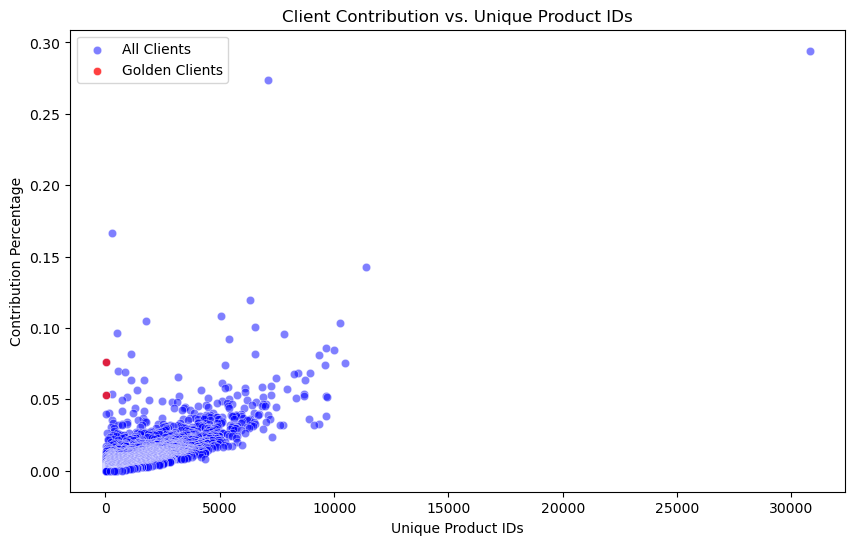

In [ ]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x='unique_product_ids', y='contribution_percentage', data=client_df, color='blue', alpha=0.5)
sns.scatterplot(x='unique_product_ids', y='contribution_percentage', data=golden_clients, color='red', alpha=0.75)

plt.title('Client Contribution vs. Unique Product IDs')
plt.xlabel('Unique Product IDs')
plt.ylabel('Contribution Percentage')
plt.legend(['All Clients', 'Golden Clients'])
plt.show()

In [ ]:
# Calculate the average number of unique products bought per client
average_unique_products = client_df['unique_product_ids'].mean()

# Calculate the average total sales per client
average_total_sales = client_df['total_sales_net'].mean()

print(f"Average unique products per client: {average_unique_products}")
print(f"Average total sales per client: {average_total_sales}")

Average unique products per client: 155.6897162185135
Average total sales per client: 55461.51285360742


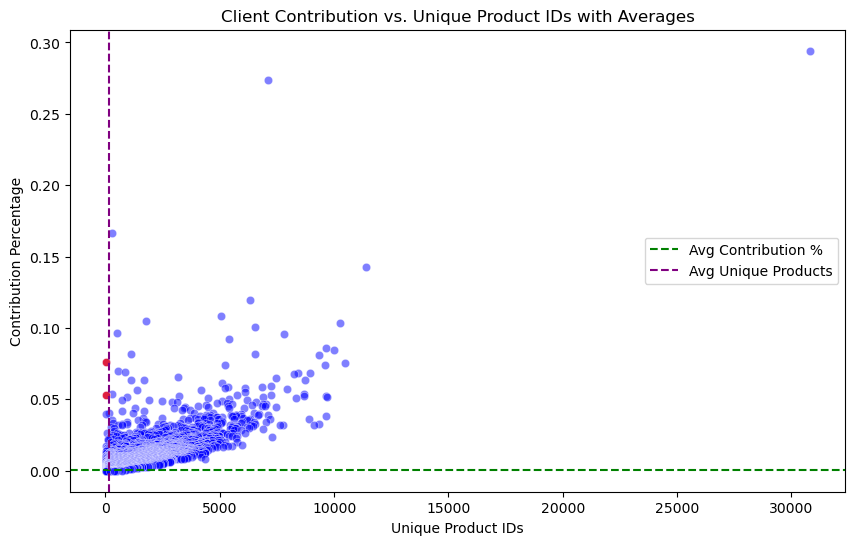

In [ ]:
plt.figure(figsize=(10, 6))

sns.scatterplot(x='unique_product_ids', y='contribution_percentage', data=client_df, color='blue', alpha=0.5)

sns.scatterplot(x='unique_product_ids', y='contribution_percentage', data=golden_clients, color='red', alpha=0.75)

plt.axhline(y=client_df['contribution_percentage'].mean(), color='green', linestyle='--', label='Avg Contribution %')
plt.axvline(x=average_unique_products, color='purple', linestyle='--', label='Avg Unique Products')

plt.title('Client Contribution vs. Unique Product IDs with Averages')
plt.xlabel('Unique Product IDs')
plt.ylabel('Contribution Percentage')
plt.legend()
plt.show()

## 3.3: Looking into the important, big clients

In [ ]:
branche_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 582 entries, 0 to 581
Data columns (total 4 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   branch_id           582 non-null    int64  
 1   unique_product_ids  582 non-null    int64  
 2   unique_client_ids   582 non-null    int64  
 3   total_sales_net     582 non-null    float64
dtypes: float64(1), int64(3)
memory usage: 18.3 KB


In [ ]:
descriptive_stats = client_df[['unique_product_ids', 'unique_branch_ids', 'total_sales_net']].describe()
print(descriptive_stats)

       unique_product_ids  unique_branch_ids  total_sales_net
count       170589.000000      170589.000000     1.689020e+05
mean           155.689716           2.508040     5.546151e+04
std            396.214366           4.708905     2.449860e+05
min              1.000000           1.000000    -9.240000e+02
25%              9.000000           1.000000     1.345000e+03
50%             35.000000           1.000000     6.329000e+03
75%            134.000000           3.000000     2.987900e+04
max          30812.000000         537.000000     2.755879e+07


In [ ]:
# Define thresholds for "much more than average" behavior
quantity_threshold = descriptive_stats.loc['mean', 'unique_product_ids'] + 2 * descriptive_stats.loc['std', 'unique_product_ids']
spending_threshold = descriptive_stats.loc['mean', 'total_sales_net'] + 2 * descriptive_stats.loc['std', 'total_sales_net']
branches_threshold = descriptive_stats.loc['mean', 'unique_branch_ids'] + 2 * descriptive_stats.loc['std', 'unique_branch_ids']

# Identify customers exceeding these thresholds
high_quantity_customers = client_df[client_df['unique_product_ids'] > quantity_threshold]
high_spending_customers = client_df[client_df['total_sales_net'] > spending_threshold]
high_branch_customers = client_df[client_df['unique_branch_ids'] > branches_threshold]

Here we are considering **big** clients, clients that have performance at least more than *mean+ 2 time standard deviation* in either:
- quantity bought
- totales sales realised
- quantity of branches interaction

C:\Users\fanny\AppData\Local\Temp\ipykernel_8168\149322724.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(client_df['unique_product_ids'], color='blue', kde=False)
C:\Users\fanny\AppData\Local\Temp\ipykernel_8168\149322724.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(client_df['tota

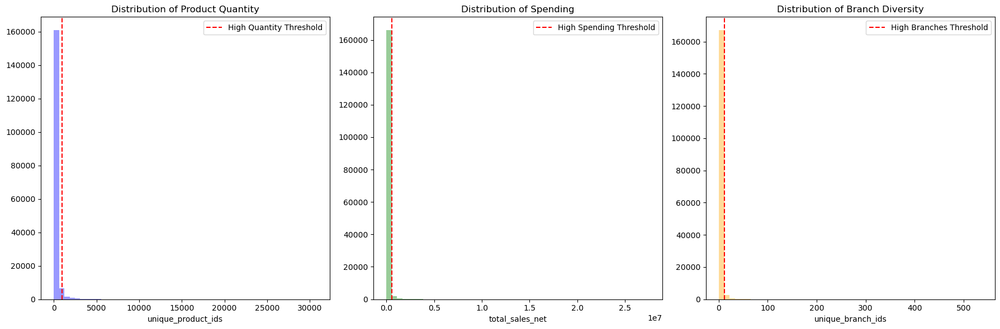

In [ ]:
plt.figure(figsize=(18, 6))

# Plot for quantity
plt.subplot(1, 3, 1)
sns.distplot(client_df['unique_product_ids'], color='blue', kde=False)
plt.axvline(x=quantity_threshold, color='red', linestyle='--', label='High Quantity Threshold')
plt.title('Distribution of Product Quantity')
plt.legend()

# Plot for spending
plt.subplot(1, 3, 2)
sns.distplot(client_df['total_sales_net'], color='green', kde=False)
plt.axvline(x=spending_threshold, color='red', linestyle='--', label='High Spending Threshold')
plt.title('Distribution of Spending')
plt.legend()

# Plot for branches
plt.subplot(1, 3, 3)
sns.distplot(client_df['unique_branch_ids'], color='orange', kde=False)
plt.axvline(x=branches_threshold, color='red', linestyle='--', label='High Branches Threshold')
plt.title('Distribution of Branch Diversity')
plt.legend()

plt.tight_layout()
plt.show()

In [ ]:
# Combine the filters to identify customers who are above the threshold in all three categories
high_performance_customers = client_df[
    (client_df['unique_product_ids'] > quantity_threshold) &
    (client_df['total_sales_net'] > spending_threshold) &
    (client_df['unique_branch_ids'] > branches_threshold)
]

In [ ]:
high_performance_customers

,client_id,unique_product_ids,unique_branch_ids,total_sales_net,contribution_percentage
0,417576,30812,537,27558787.0,0.294194
155,1552980,11379,47,13387330.0,0.142912
17787,2207247,6324,4,11193284.0,0.119490
7,2212698,1792,205,9853509.0,0.105188
1,324012,10251,495,9700475.0,0.103554
...,...,...,...,...,...
5525,1460289,965,9,122843.0,0.001311
10852,1414399,994,6,117873.0,0.001258
6827,1746701,952,8,116285.0,0.001241
19836,17213,988,4,115261.0,0.001230


In [ ]:
# Identify customers exceeding any one of the thresholds
high_performance_any_customers = client_df[
    (client_df['unique_product_ids'] > quantity_threshold) |
    (client_df['total_sales_net'] > spending_threshold) |
    (client_df['unique_branch_ids'] > branches_threshold)
]
high_performance_any_customers

,client_id,unique_product_ids,unique_branch_ids,total_sales_net,contribution_percentage
0,417576,30812,537,27558787.0,2.941939e-01
83226,1773169,7105,1,25659791.0,2.739218e-01
83227,1913629,271,1,15578727.0,1.663051e-01
155,1552980,11379,47,13387330.0,1.429116e-01
17787,2207247,6324,4,11193284.0,1.194899e-01
...,...,...,...,...,...
17786,1872543,25,5,0.0,0.000000e+00
26417,592793,417,4,-3.0,-3.202541e-08
26418,1540128,31,4,-11.0,-1.174265e-07
26419,1867425,52,4,-246.0,-2.626084e-06


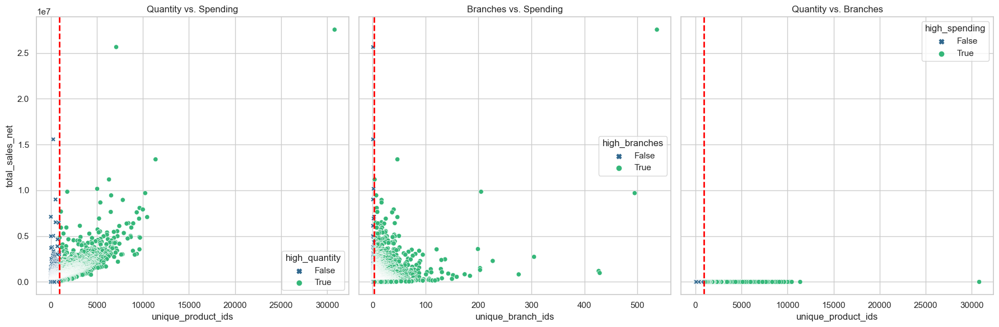

In [ ]:
sns.set(style="whitegrid")

# New DataFrame flagging high performance customers
client_df['high_quantity'] = client_df['unique_product_ids'] > quantity_threshold
client_df['high_spending'] = client_df['total_sales_net'] > spending_threshold
client_df['high_branches'] = client_df['unique_branch_ids'] > branches_threshold

fig, axes = plt.subplots(1, 3, figsize=(18, 6), sharey=True)

# Scatter plot for quantity vs. spending
sns.scatterplot(ax=axes[0], data=client_df, x='unique_product_ids', y='total_sales_net', hue='high_quantity', style='high_quantity', markers={True: 'o', False: 'X'}, palette='viridis')
axes[0].axvline(quantity_threshold, color='red', lw=2, ls='--')
axes[0].set_title('Quantity vs. Spending')

# Scatter plot for branches vs. spending
sns.scatterplot(ax=axes[1], data=client_df, x='unique_branch_ids', y='total_sales_net', hue='high_branches', style='high_branches', markers={True: 'o', False: 'X'}, palette='viridis')
axes[1].axvline(branches_threshold, color='red', lw=2, ls='--')
axes[1].set_title('Branches vs. Spending')

# Scatter plot for quantity vs. branches
sns.scatterplot(ax=axes[2], data=client_df, x='unique_product_ids', y='unique_branch_ids', hue='high_spending', style='high_spending', markers={True: 'o', False: 'X'}, palette='viridis')
axes[2].axvline(quantity_threshold, color='red', lw=2, ls='--')
axes[2].set_title('Quantity vs. Branches')

plt.tight_layout()
plt.show()

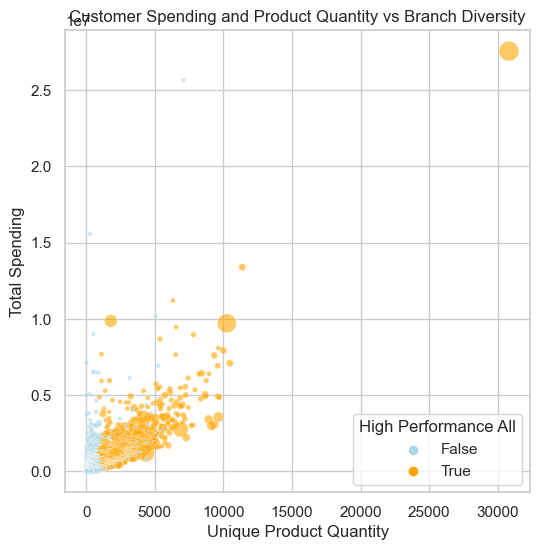

In [ ]:
# Flag in the DataFrame for high performance in all categories
client_df['high_performance_all'] = client_df.index.isin(high_performance_customers.index)

# Filter for only those customers who are above at least one threshold
high_performance_any = client_df[client_df.index.isin(high_performance_any_customers.index)]


plt.figure(figsize=(6, 6))
scatter = sns.scatterplot(
    data=high_performance_any,
    x='unique_product_ids',
    y='total_sales_net',
    size='unique_branch_ids',
    sizes=(10, 200),
    hue='high_performance_all',
    palette=['lightblue', 'orange'],
    alpha=0.6,
    edgecolor='w'
)

h, l = scatter.get_legend_handles_labels()
plt.legend(h[1:3], l[1:3], title='High Performance All')

plt.xlabel('Unique Product Quantity')
plt.ylabel('Total Spending')
plt.title('Customer Spending and Product Quantity vs Branch Diversity')

plt.show()

C:\Users\fanny\AppData\Local\Temp\ipykernel_8168\430016366.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  high_branch_customers['high_performance_any'] = high_branch_customers.index.isin(high_performance_any_customers.index)
C:\Users\fanny\AppData\Local\Temp\ipykernel_8168\430016366.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  high_branch_customers['high_performance_all'] = high_branch_customers.index.isin(high_performance_customers.index)


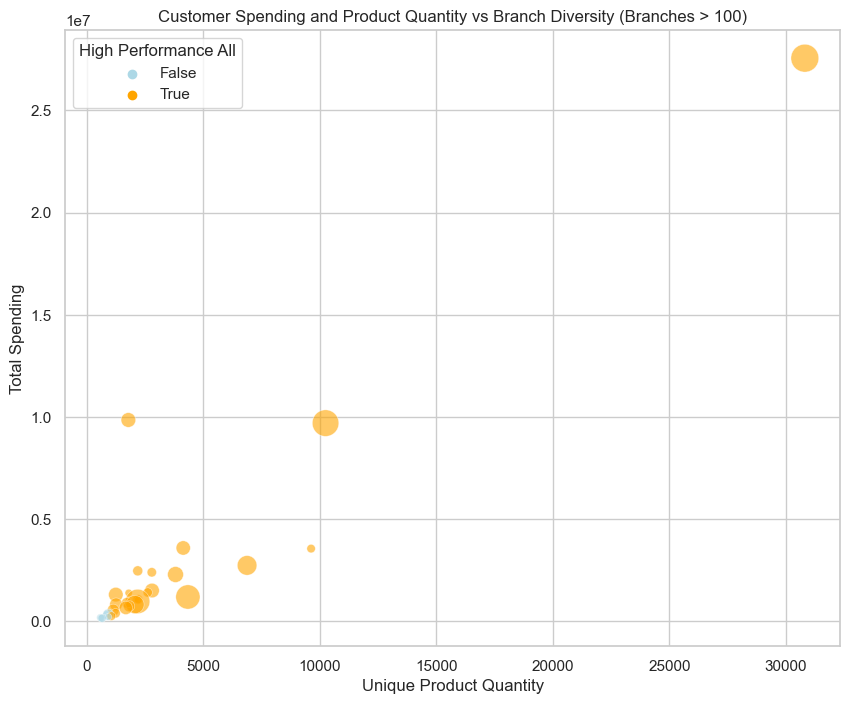

In [ ]:
# Filter for customers with unique_branch_ids greater than 100
high_branch_customers = client_df[client_df['unique_branch_ids'] > 100]

# Flag for high performance in any category
high_branch_customers['high_performance_any'] = high_branch_customers.index.isin(high_performance_any_customers.index)

# Flag for high performance in all categories
high_branch_customers['high_performance_all'] = high_branch_customers.index.isin(high_performance_customers.index)

plt.figure(figsize=(10, 8))
scatter = sns.scatterplot(
    data=high_branch_customers,
    x='unique_product_ids',
    y='total_sales_net',
    size='unique_branch_ids',
    sizes=(20, 400),
    hue='high_performance_all',
    palette=['lightblue', 'orange'],
    alpha=0.6,
    edgecolor='w'
)

h, l = scatter.get_legend_handles_labels()
plt.legend(h[1:3], l[1:3], title='High Performance All')

plt.xlabel('Unique Product Quantity')
plt.ylabel('Total Spending')
plt.title('Customer Spending and Product Quantity vs Branch Diversity (Branches > 100)')

plt.show()

In [ ]:
high_branch_customers.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 33 entries, 0 to 24
Data columns (total 10 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   client_id                33 non-null     int64  
 1   unique_product_ids       33 non-null     int64  
 2   unique_branch_ids        33 non-null     int64  
 3   total_sales_net          33 non-null     float64
 4   contribution_percentage  33 non-null     float64
 5   high_quantity            33 non-null     bool   
 6   high_spending            33 non-null     bool   
 7   high_branches            33 non-null     bool   
 8   high_performance_all     33 non-null     bool   
 9   high_performance_any     33 non-null     bool   
dtypes: bool(5), float64(2), int64(3)
memory usage: 1.7 KB


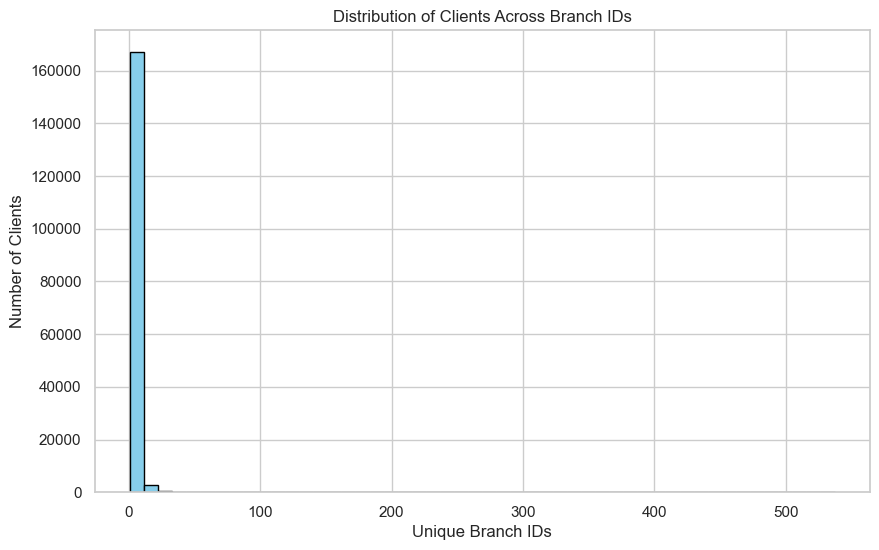

In [ ]:
plt.figure(figsize=(10, 6))
plt.hist(client_df['unique_branch_ids'], bins=50, color='skyblue', edgecolor='black')

plt.title('Distribution of Clients Across Branch IDs')
plt.xlabel('Unique Branch IDs')
plt.ylabel('Number of Clients')

plt.show()

In [ ]:
client_df.head()

,client_id,unique_product_ids,unique_branch_ids,total_sales_net,contribution_percentage,high_quantity,high_spending,high_branches,high_performance_all
0,417576,30812,537,27558787.0,0.294194,True,True,True,True
83226,1773169,7105,1,25659791.0,0.273922,True,True,False,False
83227,1913629,271,1,15578727.0,0.166305,False,True,False,False
155,1552980,11379,47,13387330.0,0.142912,True,True,True,True
17787,2207247,6324,4,11193284.0,0.119490,True,True,True,True


## 3.4: Categorizing clients based on: products & branches

**Defininf Gold Clients:**

In [ ]:
client_df

,client_id,unique_product_ids,unique_branch_ids,total_sales_net,contribution_percentage,high_quantity,high_spending,high_branches,high_performance_all
0,417576,30812,537,27558787.0,0.294194,True,True,True,True
83226,1773169,7105,1,25659791.0,0.273922,True,True,False,False
83227,1913629,271,1,15578727.0,0.166305,False,True,False,False
155,1552980,11379,47,13387330.0,0.142912,True,True,True,True
17787,2207247,6324,4,11193284.0,0.119490,True,True,True,True
...,...,...,...,...,...,...,...,...,...
83130,1266750,22,2,NaN,NaN,False,False,False,False
169715,1900581,22,1,NaN,NaN,False,False,False,False
169703,1881537,39,1,NaN,NaN,False,False,False,False
168518,232380,41,1,NaN,NaN,False,False,False,False


In [ ]:
gold_clients = client_df[client_df['contribution_percentage'] > 0.05]

In [ ]:
gold_clients.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 55 entries, 0 to 1472
Data columns (total 9 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   client_id                55 non-null     int64  
 1   unique_product_ids       55 non-null     int64  
 2   unique_branch_ids        55 non-null     int64  
 3   total_sales_net          55 non-null     float64
 4   contribution_percentage  55 non-null     float64
 5   high_quantity            55 non-null     bool   
 6   high_spending            55 non-null     bool   
 7   high_branches            55 non-null     bool   
 8   high_performance_all     55 non-null     bool   
dtypes: bool(4), float64(2), int64(3)
memory usage: 2.8 KB


In [ ]:
gold_clients.describe()

,client_id,unique_product_ids,unique_branch_ids,total_sales_net,contribution_percentage
count,5.500000e+01,55.000000,55.000000,5.500000e+01,55.000000
mean,1.234557e+06,6163.600000,39.290909,7.472092e+06,0.079766
std,6.800694e+05,4720.956065,97.866438,4.368241e+06,0.046632
min,3.121300e+04,12.000000,1.000000,4.697745e+06,0.050149
25%,5.787140e+05,3198.000000,7.000000,5.099912e+06,0.054442
50%,1.372496e+06,6324.000000,17.000000,6.108987e+06,0.065214
75%,1.805592e+06,8546.000000,26.000000,7.797267e+06,0.083237
max,2.272758e+06,30812.000000,537.000000,2.755879e+07,0.294194


In [ ]:
gold_clients

,client_id,unique_product_ids,unique_branch_ids,total_sales_net,contribution_percentage,high_quantity,high_spending,high_branches,high_performance_all,Cluster,branch_cluster,product_cluster,combined_cluster
0,417576,30812,537,27558787.0,0.294194,True,True,True,True,High-Value,>=11,>=2000,Branche >=11 & Product >=2000
83226,1773169,7105,1,25659791.0,0.273922,True,True,False,False,High-Value,=1,>=2000,Branche =1 & Product >=2000
83227,1913629,271,1,15578727.0,0.166305,False,True,False,False,High-Value,=1,<500,Branche =1 & Product <500
155,1552980,11379,47,13387330.0,0.142912,True,True,True,True,High-Value,>=11,>=2000,Branche >=11 & Product >=2000
17787,2207247,6324,4,11193284.0,0.119490,True,True,True,True,High-Value,2-10,>=2000,Branche 2-10 & Product >=2000
44013,31213,5041,2,10168487.0,0.108550,True,True,False,False,High-Value,2-10,>=2000,Branche 2-10 & Product >=2000
7,2212698,1792,205,9853509.0,0.105188,True,True,True,True,High-Value,>=11,<2000,Branche >=11 & Product <2000
1,324012,10251,495,9700475.0,0.103554,True,True,True,True,High-Value,>=11,>=2000,Branche >=11 & Product >=2000
7707,346256,6555,7,9453690.0,0.100919,True,True,True,True,High-Value,2-10,>=2000,Branche 2-10 & Product >=2000
83228,2129476,519,1,9004662.0,0.096126,False,True,False,False,High-Value,=1,<1000,Branche =1 & Product <1000


In [ ]:
# Categorize clients based on unique_branch_ids
def categorize_client(row):
    if row['unique_branch_ids'] > 100:
        return "Walmart"
    elif row['unique_branch_ids'] > 10:
        return "Medium"
    else:
        return "Local"

gold_clients['category'] = gold_clients.apply(categorize_client, axis=1)

print(gold_clients)

       client_id  unique_product_ids  unique_branch_ids  total_sales_net  \
0         417576               30812                537       27558787.0   
83226    1773169                7105                  1       25659791.0   
83227    1913629                 271                  1       15578727.0   
155      1552980               11379                 47       13387330.0   
17787    2207247                6324                  4       11193284.0   
44013      31213                5041                  2       10168487.0   
7        2212698                1792                205        9853509.0   
1         324012               10251                495        9700475.0   
7707      346256                6555                  7        9453690.0   
83228    2129476                 519                  1        9004662.0   
1639      921974                7820                 17        8955573.0   
1640     1909014                5384                 17        8675188.0   
6182     143

C:\Users\fanny\AppData\Local\Temp\ipykernel_8168\3069742374.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
# Calculate the proportion of each category
category_proportions = gold_clients['category'].value_counts(normalize=True) * 100
print(category_proportions)

Medium     56.363636
Local      38.181818
Walmart     5.454545
Name: category, dtype: float64


In [ ]:
# Sum the total contribution of big clients
total_contribution = big_clients['contribution_percentage'].sum()
print(f"Total Contribution of Big Clients: {total_contribution:.2f}%")

Total Contribution of Big Clients: 4.39%


In [ ]:
rfm_score.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170589 entries, 0 to 170588
Data columns (total 13 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   client_id       170589 non-null  int64  
 1   date_order_max  170589 non-null  object 
 2   Recency         170589 non-null  int64  
 3   T               170589 non-null  int64  
 4   MonetaryValue   170589 non-null  float64
 5   Frequency       170589 non-null  int64  
 6   RecencyScore    170589 non-null  int64  
 7   FrequencyScore  170589 non-null  int64  
 8   MonetaryScore   170589 non-null  int64  
 9   RFM_Segment     170589 non-null  int64  
 10  RFM_Score       170589 non-null  int64  
 11  RFM_Level       170589 non-null  object 
 12  Is_Churned      170589 non-null  bool   
dtypes: bool(1), float64(1), int64(9), object(2)
memory usage: 15.8+ MB


In [ ]:
gold_clients['client_id'] = gold_clients['client_id'].astype(int)
rfm_score['client_id'] = rfm_score['client_id'].astype(int)

# Merge the two DataFrames
gold_clients_all = pd.merge(gold_clients, rfm_score, on='client_id', how='inner')

C:\Users\fanny\AppData\Local\Temp\ipykernel_8168\3147411046.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
gold_clients_all.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 55 entries, 0 to 54
Data columns (total 26 columns):
 #   Column                   Non-Null Count  Dtype   
---  ------                   --------------  -----   
 0   client_id                55 non-null     int32   
 1   unique_product_ids       55 non-null     int64   
 2   unique_branch_ids        55 non-null     int64   
 3   total_sales_net          55 non-null     float64 
 4   contribution_percentage  55 non-null     float64 
 5   high_quantity            55 non-null     bool    
 6   high_spending            55 non-null     bool    
 7   high_branches            55 non-null     bool    
 8   high_performance_all     55 non-null     bool    
 9   Cluster                  55 non-null     object  
 10  branch_cluster           55 non-null     category
 11  product_cluster          55 non-null     category
 12  combined_cluster         55 non-null     object  
 13  category                 55 non-null     object  
 14  date_order_m

In [ ]:
# First, we'll look at the distribution of RFM Levels among gold clients
rfm_level_distribution = gold_clients_all['RFM_Level'].value_counts()
rfm_level_distribution

Champions             54
Potential Loyalist     1
Name: RFM_Level, dtype: int64

In [ ]:
# To understand their buying frequency, we can summarize the 'Frequency' column
average_frequency = gold_clients_all['Frequency'].mean()
average_frequency

31454.381818181817

In [ ]:
# To check if any have churned, we will look at the 'Is_Churned' column and consider those with Recency > 6 months
churned_clients = gold_clients_all[gold_clients_all['Recency'] > 180]['Is_Churned'].sum()
churned_clients

0

**Looking into other customers:**

In [ ]:
big_client_ids = big_clients['client_id'].unique()
normal_customer = client_df[~client_df['client_id'].isin(big_client_ids)]

print(normal_customer.head())

       client_id  unique_product_ids  unique_branch_ids  total_sales_net  \
2075      551651                6202                 15        4668269.0   
3106     1722816                1915                 12        4660182.0   
44015     631876                 743                  2        4649854.0   
17788    1708388                5108                  4        4574948.0   
17789    1344561                2476                  4        4553351.0   

       contribution_percentage  high_quantity  high_spending  high_branches  \
2075                  0.049834           True           True           True   
3106                  0.049748           True           True           True   
44015                 0.049638          False           True          False   
17788                 0.048838           True           True           True   
17789                 0.048608           True           True           True   

       high_performance_all  
2075                   True  
3106    

In [ ]:
total_contribution_bis = normal_customer['contribution_percentage'].sum()

print(f"Total Contribution of Clients excluding Gold clients: {total_contribution_bis:.2f}%")

Total Contribution of Clients excluding Gold clients: 95.61%


In [ ]:
normal_customer.describe()

,client_id,unique_product_ids,unique_branch_ids,total_sales_net,contribution_percentage
count,1.705340e+05,170534.000000,170534.000000,1.688470e+05,168847.000000
mean,1.139279e+06,153.752067,2.496177,5.304563e+04,0.000566
std,6.567632e+05,371.932791,4.325688,1.897667e+05,0.002026
min,6.000000e+00,1.000000,1.000000,-9.240000e+02,-0.000010
25%,5.702582e+05,9.000000,1.000000,1.344000e+03,0.000014
50%,1.140368e+06,35.000000,1.000000,6.323000e+03,0.000067
75%,1.709722e+06,133.000000,3.000000,2.981850e+04,0.000318
max,2.274517e+06,9631.000000,429.000000,4.668269e+06,0.049834


In [ ]:
# Portion of customers for which branch_id = 1
customers_branch_1 = client_df[client_df['unique_branch_ids'] == 1]
portion_branch_1 = len(customers_branch_1) / len(client_df)
total_contribution_branch_1 = customers_branch_1['contribution_percentage'].sum()

# Portion of customers for which product_id < 10
customers_product_less_10 = client_df[client_df['unique_product_ids'] < 10]
portion_product_less_10 = len(customers_product_less_10) / len(client_df)
total_contribution_product_less_10 = customers_product_less_10['contribution_percentage'].sum()

# Portion of customers for which product_id < 10 and branch_id = 1
customers_product_less_10_branch_1 = client_df[(client_df['unique_product_ids'] < 10) & (client_df['unique_branch_ids'] == 1)]
portion_product_less_10_branch_1 = len(customers_product_less_10_branch_1) / len(client_df)
total_contribution_product_less_10_branch_1 = customers_product_less_10_branch_1['contribution_percentage'].sum()

# Portion of customers for which product_id < 50
customers_product_less_50 = client_df[client_df['unique_product_ids'] < 50]
portion_product_less_50 = len(customers_product_less_50) / len(client_df)
total_contribution_product_less_50 = customers_product_less_50['contribution_percentage'].sum()

# Portion of customers for which product_id < 50 and branch_id = 1
customers_product_less_50_branch_1 = client_df[(client_df['unique_product_ids'] < 50) & (client_df['unique_branch_ids'] == 1)]
portion_product_less_50_branch_1 = len(customers_product_less_50_branch_1) / len(client_df)
total_contribution_product_less_50_branch_1 = customers_product_less_50_branch_1['contribution_percentage'].sum()

print(f"Portion of customers for branch_id = 1: {portion_branch_1}, Total contribution: {total_contribution_branch_1}%")
print(f"Portion of customers for product_id < 10: {portion_product_less_10}, Total contribution: {total_contribution_product_less_10}%")
print(f"Portion of customers for product_id < 10 and branch_id = 1: {portion_product_less_10_branch_1}, Total contribution: {total_contribution_product_less_10_branch_1}%")
print(f"Portion of customers for product_id < 50: {portion_product_less_50}, Total contribution: {total_contribution_product_less_50}%")
print(f"Portion of customers for product_id < 50 and branch_id = 1: {portion_product_less_50_branch_1}, Total contribution: {total_contribution_product_less_50_branch_1}%")

Portion of customers for branch_id = 1: 0.5121256352988762, Total contribution: 13.245699437090284%
Portion of customers for product_id < 10: 0.2617812402909918, Total contribution: 0.7803771690293456%
Portion of customers for product_id < 10 and branch_id = 1: 0.2221714178522648, Total contribution: 0.6256321200205112%
Portion of customers for product_id < 50: 0.5667012527185223, Total contribution: 4.520136310102042%
Portion of customers for product_id < 50 and branch_id = 1: 0.3990702800297792, Total contribution: 2.534361357145676%


In [ ]:
client_df['total_sales_net'] = pd.to_numeric(client_df['total_sales_net'], errors='coerce')

# Overall total sales net sum
total_sales_net_sum = client_df['total_sales_net'].sum()

# Categories
conditions = [
    client_df['unique_branch_ids'] == 1,
    client_df['unique_branch_ids'] < 10,
    client_df['unique_branch_ids'] > 200,
    client_df['unique_product_ids'] < 10,
    (client_df['unique_product_ids'] < 10) & (client_df['unique_branch_ids'] == 1),
    client_df['unique_product_ids'] < 50,
    (client_df['unique_product_ids'] < 50) & (client_df['unique_branch_ids'] == 1),
    client_df['unique_product_ids'] < 100,
    client_df['unique_product_ids'] > 500,
    client_df['unique_product_ids'] > 1000,
    client_df['unique_product_ids'] > 2000,
]

category_names = [
    "branch_id=1",
    "branch_id<10",
    "branch_id>200",
    "product_id<10",
    "product_id<10 and branch_id=1",
    "product_id<50",
    "product_id<50 and branch_id=1",
    "product_id<100",
    "product_id>500",
    "product_id>1000",
    "product_id>2000",
]

# Calculate contributions and proportions for each category
for condition, name in zip(conditions, category_names):
    category_clients = client_df[condition]
    category_sales_sum = category_clients['total_sales_net'].sum()
    category_contribution_percentage = (category_sales_sum / total_sales_net_sum) * 100
    category_client_proportion = (len(category_clients) / len(client_df)) * 100

    print(f"{name}: Proportion of Clients: {category_client_proportion:.2f}%, Contribution to Sales: {category_contribution_percentage:.2f}%")

branch_id=1: Proportion of Clients: 51.21%, Contribution to Sales: 13.25%
branch_id<10: Proportion of Clients: 97.03%, Contribution to Sales: 75.45%
branch_id>200: Proportion of Clients: 0.01%, Contribution to Sales: 0.62%
product_id<10: Proportion of Clients: 26.18%, Contribution to Sales: 0.78%
product_id<10 and branch_id=1: Proportion of Clients: 22.22%, Contribution to Sales: 0.63%
product_id<50: Proportion of Clients: 56.67%, Contribution to Sales: 4.52%
product_id<50 and branch_id=1: Proportion of Clients: 39.91%, Contribution to Sales: 2.53%
product_id<100: Proportion of Clients: 69.91%, Contribution to Sales: 8.95%
product_id>500: Proportion of Clients: 7.60%, Contribution to Sales: 64.02%
product_id>1000: Proportion of Clients: 2.74%, Contribution to Sales: 43.78%
product_id>2000: Proportion of Clients: 0.83%, Contribution to Sales: 24.43%


In [ ]:
branche_df.describe()

,branch_id,unique_product_ids,unique_client_ids,total_sales_net
count,582.000000,582.000000,582.000000,5.820000e+02
mean,5434.219931,14084.608247,735.127148,1.609546e+07
std,3308.792511,10488.031783,582.690127,1.791780e+07
min,20.000000,1.000000,1.000000,-1.136868e-13
25%,2654.000000,8557.250000,344.500000,5.870715e+06
50%,5174.000000,13102.500000,627.000000,1.154457e+07
75%,8607.500000,18782.500000,1061.500000,1.969132e+07
max,11057.000000,58906.000000,3797.000000,1.226202e+08


In [ ]:
conditions = [
    (client_df['total_sales_net'] > client_df['total_sales_net'].quantile(0.75)),
    (client_df['unique_product_ids'] > client_df['unique_product_ids'].quantile(0.75)),
    (client_df['unique_branch_ids'] <= 10) & (client_df['total_sales_net'].between(client_df['total_sales_net'].median(), client_df['total_sales_net'].quantile(0.75))),
    (client_df['unique_product_ids'] < 50) & (client_df['total_sales_net'] > client_df['total_sales_net'].median()),
    (client_df['unique_product_ids'] < 10) & (client_df['unique_branch_ids'] == 1)
]
choices = ['High-Value', 'Frequent Shopper', 'Local Loyalist', 'Selective Shopper', 'Opportunistic']
client_df['Cluster'] = np.select(conditions, choices, default='Other')

In [ ]:
client_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 170589 entries, 0 to 169322
Data columns (total 10 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   client_id                170589 non-null  int64  
 1   unique_product_ids       170589 non-null  int64  
 2   unique_branch_ids        170589 non-null  int64  
 3   total_sales_net          168902 non-null  float64
 4   contribution_percentage  168902 non-null  float64
 5   high_quantity            170589 non-null  bool   
 6   high_spending            170589 non-null  bool   
 7   high_branches            170589 non-null  bool   
 8   high_performance_all     170589 non-null  bool   
 9   Cluster                  170589 non-null  object 
dtypes: bool(4), float64(2), int64(3), object(1)
memory usage: 9.8+ MB


In [ ]:
# Calculate the proportion of customers in each cluster
customer_proportions = client_df['Cluster'].value_counts(normalize=True) * 100

# Calculate the total sales contribution by cluster
cluster_sales_contribution = client_df.groupby('Cluster')['total_sales_net'].sum()
total_sales = cluster_sales_contribution.sum()
sales_contribution_percentage = (cluster_sales_contribution / total_sales) * 100

cluster_summary = pd.DataFrame({
    'Customer Proportion (%)': customer_proportions,
    'Sales Contribution (%)': sales_contribution_percentage
}).sort_values(by='Sales Contribution (%)', ascending=False)

print(cluster_summary)

                   Customer Proportion (%)  Sales Contribution (%)
High-Value                       24.752475               91.610725
Local Loyalist                   20.651390                5.083232
Frequent Shopper                  3.989120                1.544496
Other                            29.185938                1.456472
Opportunistic                    21.410525                0.302916
Selective Shopper                 0.010552                0.002158


In [ ]:
client_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 170589 entries, 0 to 169322
Data columns (total 10 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   client_id                170589 non-null  int64  
 1   unique_product_ids       170589 non-null  int64  
 2   unique_branch_ids        170589 non-null  int64  
 3   total_sales_net          168902 non-null  float64
 4   contribution_percentage  168902 non-null  float64
 5   high_quantity            170589 non-null  bool   
 6   high_spending            170589 non-null  bool   
 7   high_branches            170589 non-null  bool   
 8   high_performance_all     170589 non-null  bool   
 9   Cluster                  170589 non-null  object 
dtypes: bool(4), float64(2), int64(3), object(1)
memory usage: 9.8+ MB


In [ ]:
# Adjusting the 'branch_cluster' and 'product_cluster' column creation to match specific categories
client_df['branch_cluster'] = pd.cut(client_df['unique_branch_ids'],
                                     bins=[0, 1, 10, float('inf')],
                                     labels=['=1', '2-10', '>=11'],
                                     include_lowest=True)

client_df['product_cluster'] = pd.cut(client_df['unique_product_ids'],
                                      bins=[0, 50, 100, 500, 1000, 2000, float('inf')],
                                      labels=['<50', '<100', '<500', '<1000', '<2000', '>=2000'],
                                      include_lowest=True)

print(client_df.head())

       client_id  unique_product_ids  unique_branch_ids  total_sales_net  \
0         417576               30812                537       27558787.0   
83226    1773169                7105                  1       25659791.0   
83227    1913629                 271                  1       15578727.0   
155      1552980               11379                 47       13387330.0   
17787    2207247                6324                  4       11193284.0   

       contribution_percentage  high_quantity  high_spending  high_branches  \
0                     0.294194           True           True           True   
83226                 0.273922           True           True          False   
83227                 0.166305          False           True          False   
155                   0.142912           True           True           True   
17787                 0.119490           True           True           True   

       high_performance_all     Cluster branch_cluster product_clust

In [ ]:
# Create a new column that combines 'branch_cluster' and 'product_cluster' with an underscore
client_df['combined_cluster'] = 'Branche ' + client_df['branch_cluster'].astype(str) + ' & ' +'Product ' + client_df['product_cluster'].astype(str)

print(client_df.head())

       client_id  unique_product_ids  unique_branch_ids  total_sales_net  \
0         417576               30812                537       27558787.0   
83226    1773169                7105                  1       25659791.0   
83227    1913629                 271                  1       15578727.0   
155      1552980               11379                 47       13387330.0   
17787    2207247                6324                  4       11193284.0   

       contribution_percentage  high_quantity  high_spending  high_branches  \
0                     0.294194           True           True           True   
83226                 0.273922           True           True          False   
83227                 0.166305          False           True          False   
155                   0.142912           True           True           True   
17787                 0.119490           True           True           True   

       high_performance_all     Cluster branch_cluster product_clust

In [ ]:
# Get unique values of the 'combined_cluster' column
unique_clusters = client_df['combined_cluster'].unique()
print("Unique Cluster Categories:")
print(unique_clusters)

# Calculate the percentage distribution of clients across each category
client_distribution = client_df['combined_cluster'].value_counts(normalize=True) * 100
print("\nClient Percentage Distribution Across Each Category:")
print(client_distribution)

Unique Cluster Categories:
['Branche >=11 & Product >=2000' 'Branche =1 & Product >=2000'
 'Branche =1 & Product <500' 'Branche 2-10 & Product >=2000'
 'Branche >=11 & Product <2000' 'Branche =1 & Product <1000'
 'Branche 2-10 & Product <2000' 'Branche 2-10 & Product <50'
 'Branche >=11 & Product <1000' 'Branche 2-10 & Product <1000'
 'Branche =1 & Product <50' 'Branche 2-10 & Product <500'
 'Branche >=11 & Product <500' 'Branche =1 & Product <100'
 'Branche =1 & Product <2000' 'Branche 2-10 & Product <100'
 'Branche >=11 & Product <100' 'Branche >=11 & Product <50']

Client Percentage Distribution Across Each Category:
Branche =1 & Product <50         40.086407
Branche 2-10 & Product <50       16.938372
Branche 2-10 & Product <500      16.036790
Branche 2-10 & Product <100       7.655828
Branche =1 & Product <500         5.329769
Branche =1 & Product <100         5.312769
Branche 2-10 & Product <1000      3.856638
Branche 2-10 & Product <2000      1.340649
Branche >=11 & Product <500 

In [ ]:
# Calculate the total sales for each 'combined_cluster' category
sales_by_cluster = client_df.groupby('combined_cluster')['total_sales_net'].sum()

# Calculate the total sales across all clients for normalization
total_sales = client_df['total_sales_net'].sum()

# Calculate the contribution percentage of each cluster category to the total sales
sales_contribution_percentage = (sales_by_cluster / total_sales) * 100

# Combine the client distribution and sales contribution
combined_distribution = pd.DataFrame({
    'Client Percentage': client_distribution,
    'Sales Contribution Percentage': sales_contribution_percentage
}).reset_index().rename(columns={'index': 'Combined Cluster'})

print("Combined Cluster Distribution and Sales Contribution:")
print(combined_distribution)

Combined Cluster Distribution and Sales Contribution:
                 Combined Cluster  Client Percentage  \
0     Branche 2-10 & Product <100           7.655828   
1    Branche 2-10 & Product <1000           3.856638   
2    Branche 2-10 & Product <2000           1.340649   
3      Branche 2-10 & Product <50          16.938372   
4     Branche 2-10 & Product <500          16.036790   
5   Branche 2-10 & Product >=2000           0.479515   
6       Branche =1 & Product <100           5.312769   
7      Branche =1 & Product <1000           0.383964   
8      Branche =1 & Product <2000           0.075620   
9        Branche =1 & Product <50          40.086407   
10      Branche =1 & Product <500           5.329769   
11    Branche =1 & Product >=2000           0.024034   
12    Branche >=11 & Product <100           0.087931   
13   Branche >=11 & Product <1000           0.627825   
14   Branche >=11 & Product <2000           0.487136   
15     Branche >=11 & Product <50           0.0181

In [ ]:
combined_distribution

,Combined Cluster,Client Percentage,Sales Contribution Percentage
0,Branche 2-10 & Product <100,7.655828,2.720908
1,Branche 2-10 & Product <1000,3.856638,15.520241
2,Branche 2-10 & Product <2000,1.340649,12.960335
3,Branche 2-10 & Product <50,16.938372,2.031191
4,Branche 2-10 & Product <500,16.036790,19.635475
5,Branche 2-10 & Product >=2000,0.479515,11.805987
6,Branche =1 & Product <100,5.312769,1.675673
7,Branche =1 & Product <1000,0.383964,1.723386
8,Branche =1 & Product <2000,0.075620,0.679560
9,Branche =1 & Product <50,40.086407,2.580743


## 3.5. Adding RFM:

In [ ]:
client_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 170589 entries, 0 to 169322
Data columns (total 13 columns):
 #   Column                   Non-Null Count   Dtype   
---  ------                   --------------   -----   
 0   client_id                170589 non-null  int64   
 1   unique_product_ids       170589 non-null  int64   
 2   unique_branch_ids        170589 non-null  int64   
 3   total_sales_net          168902 non-null  float64 
 4   contribution_percentage  168902 non-null  float64 
 5   high_quantity            170589 non-null  bool    
 6   high_spending            170589 non-null  bool    
 7   high_branches            170589 non-null  bool    
 8   high_performance_all     170589 non-null  bool    
 9   Cluster                  170589 non-null  object  
 10  branch_cluster           170589 non-null  category
 11  product_cluster          170589 non-null  category
 12  combined_cluster         170589 non-null  object  
dtypes: bool(4), category(2), float64(2), int64(3

In [ ]:
rfm_score.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170589 entries, 0 to 170588
Data columns (total 13 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   client_id       170589 non-null  int64  
 1   date_order_max  170589 non-null  object 
 2   Recency         170589 non-null  int64  
 3   T               170589 non-null  int64  
 4   MonetaryValue   170589 non-null  float64
 5   Frequency       170589 non-null  int64  
 6   RecencyScore    170589 non-null  int64  
 7   FrequencyScore  170589 non-null  int64  
 8   MonetaryScore   170589 non-null  int64  
 9   RFM_Segment     170589 non-null  int64  
 10  RFM_Score       170589 non-null  int64  
 11  RFM_Level       170589 non-null  object 
 12  Is_Churned      170589 non-null  bool   
dtypes: bool(1), float64(1), int64(9), object(2)
memory usage: 15.8+ MB


In [ ]:
rfm_score.head()

,client_id,date_order_max,Recency,T,MonetaryValue,Frequency,RecencyScore,FrequencyScore,MonetaryScore,RFM_Segment,RFM_Score,RFM_Level,Is_Churned
0,6,2019-08-13,40,695,5.882233e+03,40,3,3,3,333,9,Need Attention,False
1,7,2018-12-24,272,433,1.190777e+03,15,2,2,2,222,6,At Risk,True
2,14,2019-09-20,2,727,3.154930e+06,12762,5,5,5,555,15,Champions,False
3,18,2019-09-12,10,726,2.456277e+05,2224,5,5,5,555,15,Champions,False
4,25,2018-10-10,347,347,3.745861e+02,4,1,1,1,111,3,Hibernating,True


In [ ]:
# Merging the two DataFrames on 'client_id'
client_all = pd.merge(client_df, rfm_score, on='client_id', how='outer')
print(client_all.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 170589 entries, 0 to 170588
Data columns (total 25 columns):
 #   Column                   Non-Null Count   Dtype   
---  ------                   --------------   -----   
 0   client_id                170589 non-null  int64   
 1   unique_product_ids       170589 non-null  int64   
 2   unique_branch_ids        170589 non-null  int64   
 3   total_sales_net          168902 non-null  float64 
 4   contribution_percentage  168902 non-null  float64 
 5   high_quantity            170589 non-null  bool    
 6   high_spending            170589 non-null  bool    
 7   high_branches            170589 non-null  bool    
 8   high_performance_all     170589 non-null  bool    
 9   Cluster                  170589 non-null  object  
 10  branch_cluster           170589 non-null  category
 11  product_cluster          170589 non-null  category
 12  combined_cluster         170589 non-null  object  
 13  date_order_max           170589 non-null  ob

Let's compare the RFM segmentation with the combined cluster (based on products and branches)

In [ ]:
cross_tab = pd.crosstab(client_all['RFM_Level'], client_all['combined_cluster'])
print(cross_tab)

combined_cluster    Branche 2-10 & Product <100  Branche 2-10 & Product <1000  \
RFM_Level                                                                       
At Risk                                      22                             0   
Champions                                  1798                          6316   
Hibernating                                   0                             0   
Need Attention                             2843                             0   
Potential Loyalist                         8397                           263   

combined_cluster    Branche 2-10 & Product <2000  Branche 2-10 & Product <50  \
RFM_Level                                                                      
At Risk                                        0                        8558   
Champions                                   2248                         211   
Hibernating                                    0                         941   
Need Attention                  

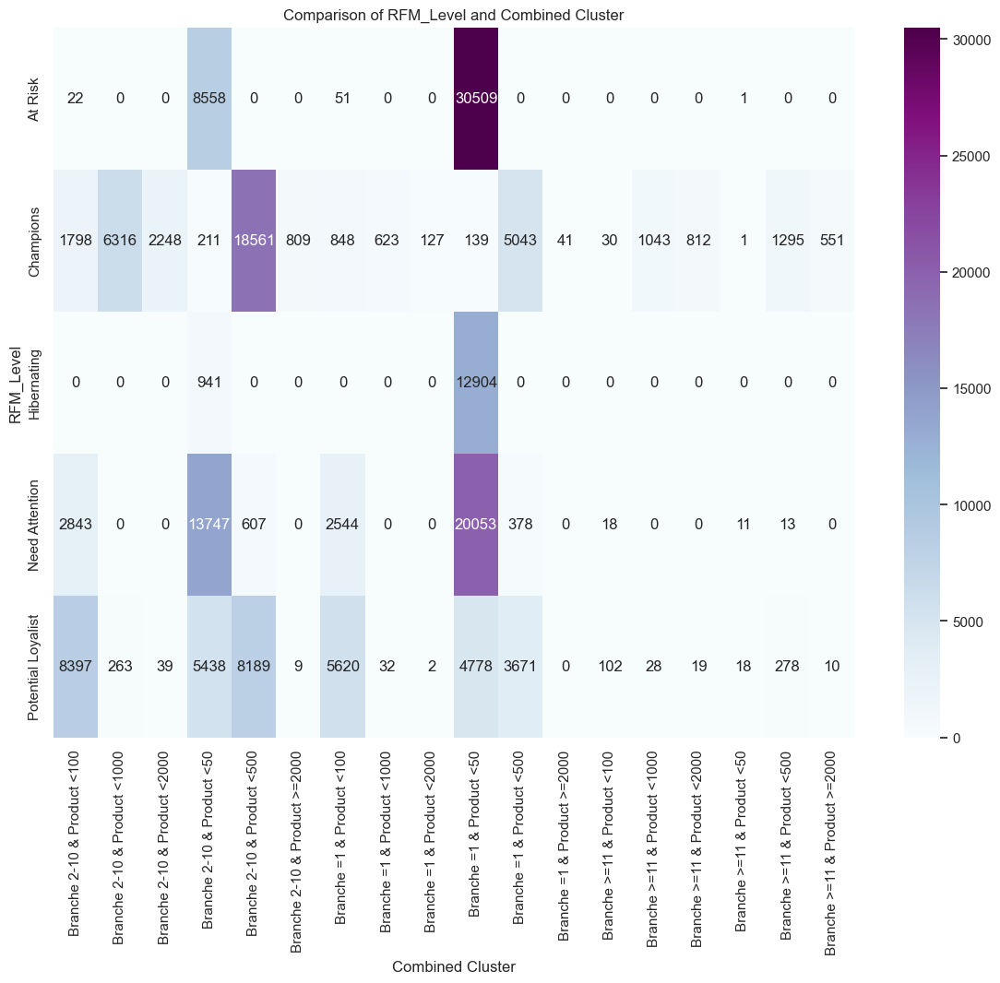

In [ ]:
plt.figure(figsize=(14, 10))
sns.heatmap(cross_tab, annot=True, fmt="d", cmap="BuPu")
plt.title('Comparison of RFM_Level and Combined Cluster')
plt.ylabel('RFM_Level')
plt.xlabel('Combined Cluster')

plt.savefig('RFM_Level_vs_Combined_Cluster_Heatmap.png')

plt.show()

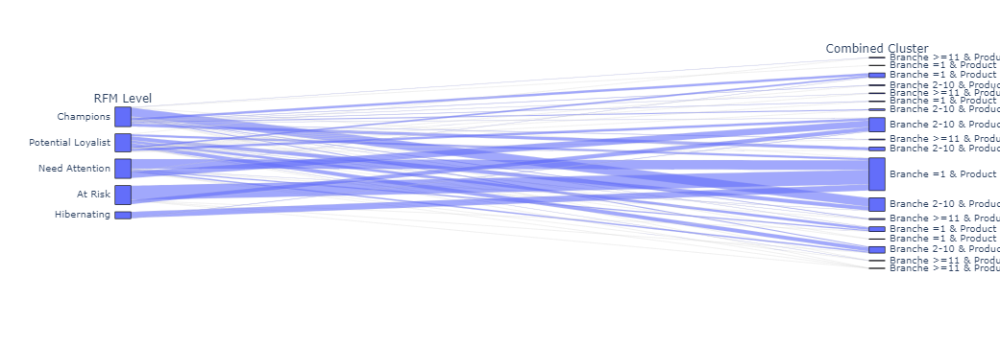

In [ ]:
fig = px.parallel_categories(client_all, dimensions=['RFM_Level', 'combined_cluster'],
                             color_continuous_scale=px.colors.sequential.Viridis,
                             labels={'RFM_Level':'RFM Level', 'combined_cluster':'Combined Cluster'})
fig.show()

In [ ]:
chi2, p, dof, expected = chi2_contingency(cross_tab)
print(f"Chi-Squared Value: {chi2}")
print(f"P-value: {p}")

Chi-Squared Value: 176871.96443661745
P-value: 0.0


Let's get more insights in our different categories

In [ ]:
# Merge the RFM_Level from client_all into data_aggregated
data_combined = pd.merge(data_aggregated, client_all[['client_id', 'RFM_Level']], on='client_id', how='left')

In [ ]:
data_combined.head()

,date_order,date_invoice,product_id,client_id,sales_net,quantity,order_channel,branch_id,cluster,lead_time,price_category,quantity_category,Recency,Frequency,MonetaryValue,RFM_Level
0,2017-09-25,2017-09-25,2376333,188502,155.443207,3,online,2732,3,0.0,average,important,678,616,66700.335938,Champions
1,2017-09-25,2017-09-25,2520527,835089,16.394400,3,at the store,10279,3,0.0,cheap,important,371,1745,291603.656250,Champions
2,2017-09-25,2017-09-25,2536756,1977896,365.766235,21,online,6184,3,0.0,cheap,important,982,517,145390.906250,Potential Loyalist
3,2017-09-25,2017-09-25,3028673,598816,8.598780,201,at the store,4200,3,0.0,cheap,important,674,3275,222614.515625,Champions
4,2017-09-25,2017-09-25,203377,2086861,1093.374023,3,by phone,7051,3,0.0,expensive,important,671,325,40332.011719,Champions


**Channel Analysis by RFM Segment:**

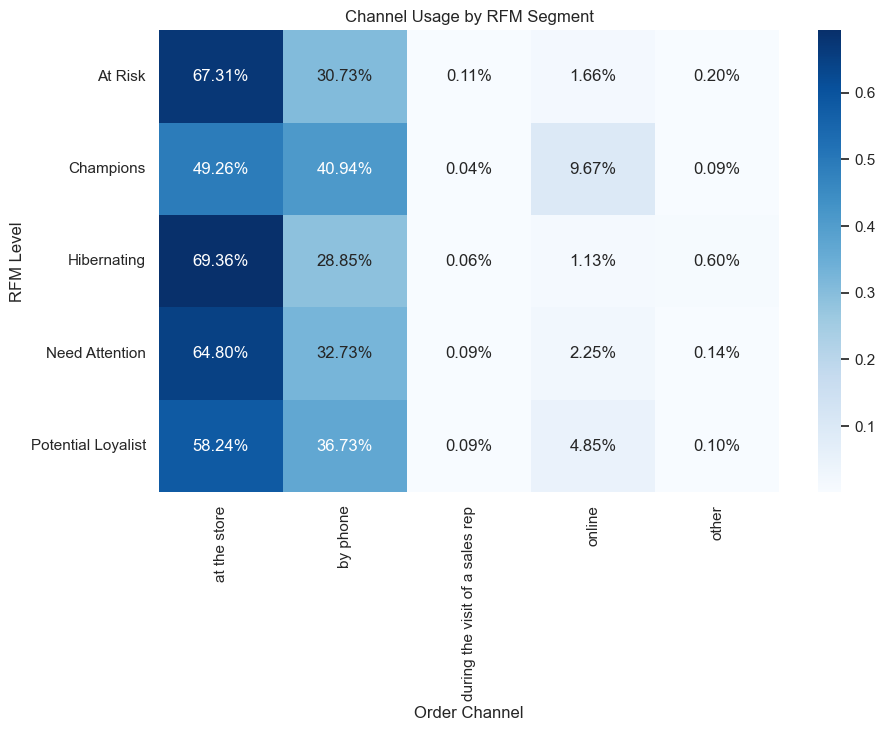

In [ ]:
# Channel Analysis
channel_usage = data_combined.groupby(['RFM_Level', 'order_channel']).size().unstack(fill_value=0)
channel_usage_normalized = channel_usage.div(channel_usage.sum(axis=1), axis=0)

plt.figure(figsize=(10, 6))
sns.heatmap(channel_usage_normalized, annot=True, fmt=".2%", cmap="Blues")
plt.title('Channel Usage by RFM Segment')
plt.ylabel('RFM Level')
plt.xlabel('Order Channel')
plt.show()

**Churn Analysis by RFM Segment:**

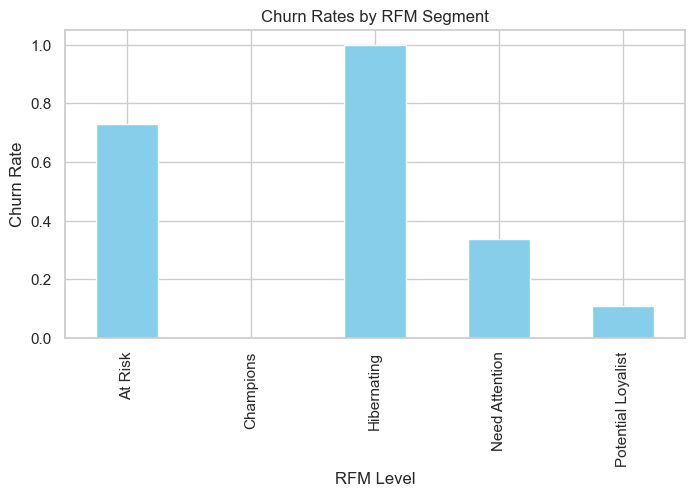

In [ ]:
# Churn Analysis
churn_rates = client_all.groupby('RFM_Level')['Is_Churned'].mean()

plt.figure(figsize=(8, 4))
churn_rates.plot(kind='bar', color='skyblue')
plt.title('Churn Rates by RFM Segment')
plt.ylabel('Churn Rate')
plt.xlabel('RFM Level')
plt.show()

### Looking into big_clients:

In [ ]:
big_clients.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 55 entries, 0 to 1472
Data columns (total 10 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   client_id                55 non-null     int64  
 1   unique_product_ids       55 non-null     int64  
 2   unique_branch_ids        55 non-null     int64  
 3   total_sales_net          55 non-null     float64
 4   contribution_percentage  55 non-null     float64
 5   high_quantity            55 non-null     bool   
 6   high_spending            55 non-null     bool   
 7   high_branches            55 non-null     bool   
 8   high_performance_all     55 non-null     bool   
 9   category                 55 non-null     object 
dtypes: bool(4), float64(2), int64(3), object(1)
memory usage: 3.2+ KB


# 4. BRANCH ANALYSIS

In [ ]:
branche_df.describe()

,branch_id,unique_product_ids,unique_client_ids,total_sales_net
count,582.000000,582.000000,582.000000,5.820000e+02
mean,5434.219931,14084.608247,735.127148,1.609546e+07
std,3308.792511,10488.031783,582.690127,1.791780e+07
min,20.000000,1.000000,1.000000,-1.136868e-13
25%,2654.000000,8557.250000,344.500000,5.870715e+06
50%,5174.000000,13102.500000,627.000000,1.154457e+07
75%,8607.500000,18782.500000,1061.500000,1.969132e+07
max,11057.000000,58906.000000,3797.000000,1.226202e+08


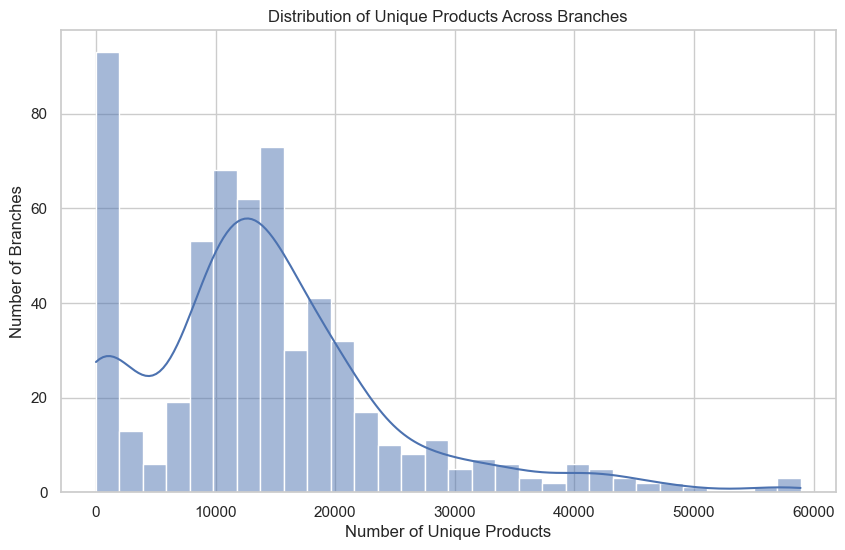

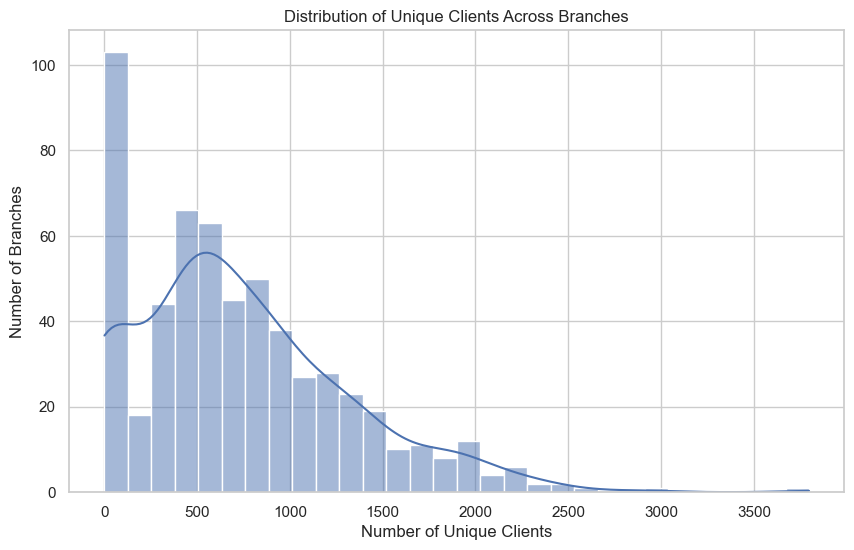

In [ ]:
# Histogram for unique_product_ids
plt.figure(figsize=(10, 6))
sns.histplot(branche_df['unique_product_ids'], bins=30, kde=True)
plt.title('Distribution of Unique Products Across Branches')
plt.xlabel('Number of Unique Products')
plt.ylabel('Number of Branches')
plt.show()

# Histogram for unique_client_ids
plt.figure(figsize=(10, 6))
sns.histplot(branche_df['unique_client_ids'], bins=30, kde=True)
plt.title('Distribution of Unique Clients Across Branches')
plt.xlabel('Number of Unique Clients')
plt.ylabel('Number of Branches')
plt.show()

In [ ]:
# Calculate the total sales net sum for all branches
total_sales_net_sum = branche_df['total_sales_net'].sum()

def calculate_sales_info(condition, description):
    condition_branches = branche_df[condition]
    count = condition_branches.shape[0]
    total_sales_net = condition_branches['total_sales_net'].sum()
    proportion_of_sales = (total_sales_net / total_sales_net_sum) * 100
    print(f"{description}: {count} Proportion: {proportion_of_sales:.3f}%")

# Branches with <10 clients
calculate_sales_info(branche_df['unique_client_ids'] < 10, "Branches with <10 clients")

# Branches selling <10 products
calculate_sales_info(branche_df['unique_product_ids'] < 10, "Branches selling <10 products")

# Branches with <100 clients
calculate_sales_info(branche_df['unique_client_ids'] < 100, "Branches with <100 clients")

# Branches selling <100 products
calculate_sales_info(branche_df['unique_product_ids'] < 100, "Branches selling <100 products")

# For branches with 0 sales net, directly calculate as there is only one
branches_zero_sales = branche_df[branche_df['total_sales_net'] == 0]
if not branches_zero_sales.empty:
    branch_id = branches_zero_sales.index[0]  # Assuming 'branch_id' is the index
    print(f"Branch with 0 sales net: {branch_id}")
    print(branches_zero_sales)

# For branches with negative sales net, similarly
branches_negative_sales = branche_df[branche_df['total_sales_net'] < 0]
if not branches_negative_sales.empty:
    branch_id = branches_negative_sales.index[0]  # Assuming 'branch_id' is the index
    print(f"Branch with negative sales net: {branch_id}")
    print(branches_negative_sales)

Branches with <10 clients: 74 Proportion: 0.477%
Branches selling <10 products: 22 Proportion: 0.020%
Branches with <100 clients: 101 Proportion: 1.579%
Branches selling <100 products: 39 Proportion: 0.059%
Branch with 0 sales net: 347
     branch_id  unique_product_ids  unique_client_ids  total_sales_net
347       6468                   2                  1              0.0
Branch with negative sales net: 580
     branch_id  unique_product_ids  unique_client_ids  total_sales_net
580      11024                   2                  1    -1.136868e-13


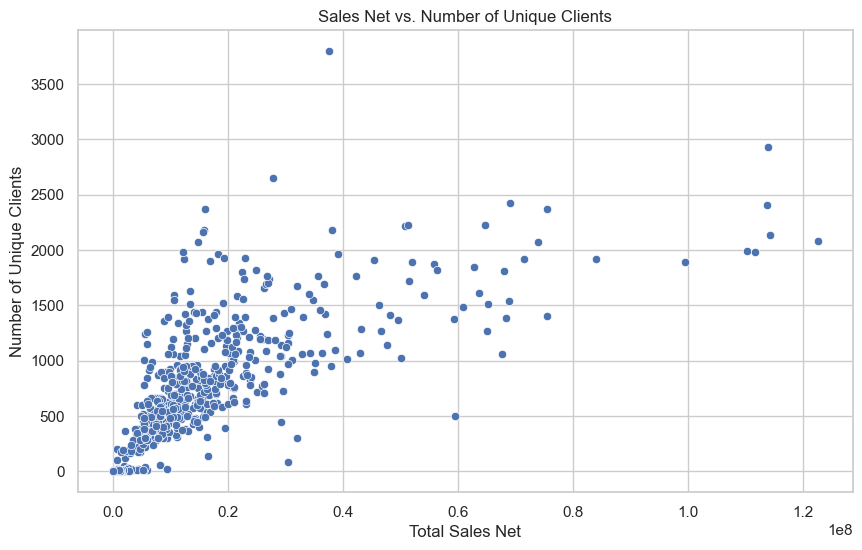

In [ ]:
# Scatter plot for sales net vs. number of unique clients
plt.figure(figsize=(10, 6))
sns.scatterplot(data=branche_df, x='total_sales_net', y='unique_client_ids')
plt.title('Sales Net vs. Number of Unique Clients')
plt.xlabel('Total Sales Net')
plt.ylabel('Number of Unique Clients')
plt.show()

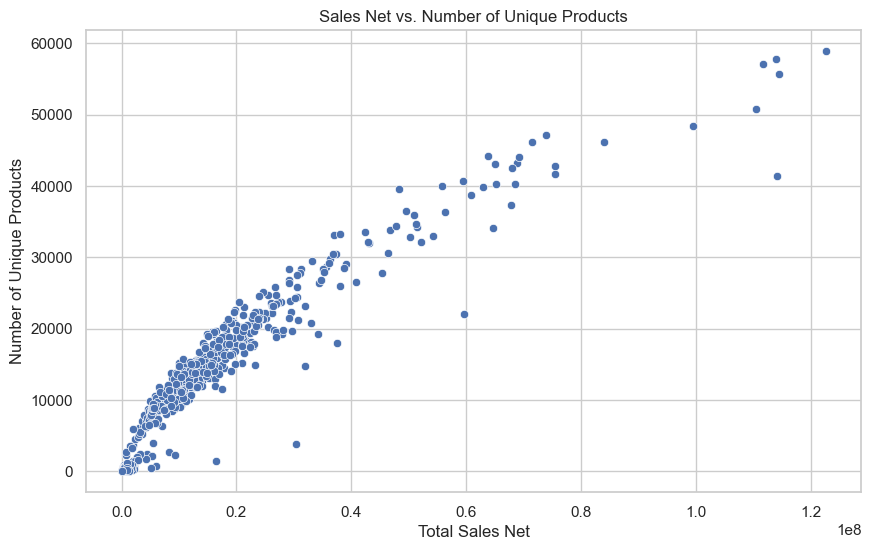

In [ ]:
# Scatter plot for sales net vs. number of unique products
plt.figure(figsize=(10, 6))
sns.scatterplot(data=branche_df, x='total_sales_net', y='unique_product_ids')
plt.title('Sales Net vs. Number of Unique Products')
plt.xlabel('Total Sales Net')
plt.ylabel('Number of Unique Products')
plt.show()

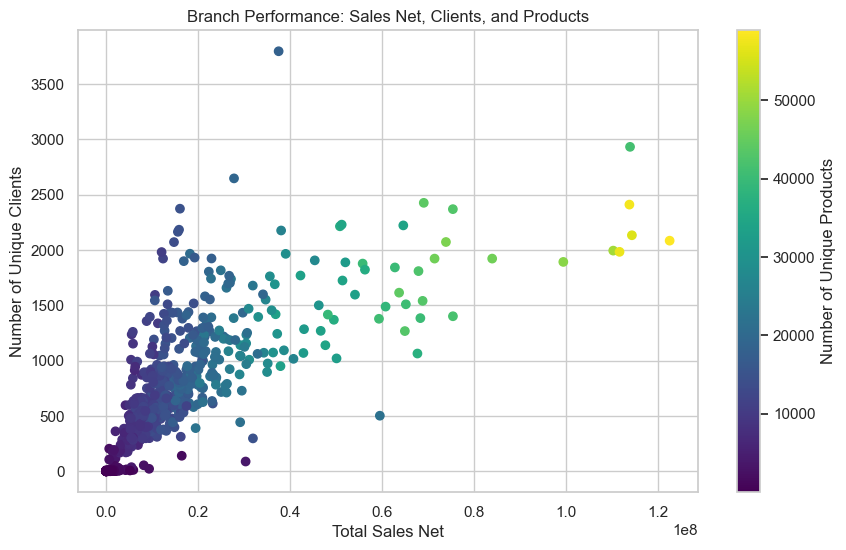

In [ ]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(10, 6))

# Scatter plot for sales net vs. number of unique clients
scatter = ax.scatter(branche_df['total_sales_net'], branche_df['unique_client_ids'],
                     c=branche_df['unique_product_ids'], cmap='viridis',
                     label='Unique Clients vs. Sales Net')

cbar = plt.colorbar(scatter)
cbar.set_label('Number of Unique Products')

ax.set_title('Branch Performance: Sales Net, Clients, and Products')
ax.set_xlabel('Total Sales Net')
ax.set_ylabel('Number of Unique Clients')

plt.show()

In [ ]:
# Group by branch_id and count unique client_ids for each branch
branch_client_counts = data_aggregated.groupby('branch_id')['client_id'].nunique().reset_index()

# Sort the results in descending order of unique client counts
branch_client_counts_sorted = branch_client_counts.sort_values(by='client_id', ascending=False)

# Identify the top 10 branches based on the number of unique clients
top_10_branches = branch_client_counts_sorted.head(10)

print("Top 10 branches based on unique client counts:")
print(top_10_branches)

# Proportion
total_unique_clients = data_aggregated['client_id'].nunique()
top_10_branches_clients_sum = top_10_branches['client_id'].sum()
proportion_of_clients_served_by_top_10 = (top_10_branches_clients_sum / total_unique_clients) * 100

print(f"\nProportion of clients served by the top 10 branches: {proportion_of_clients_served_by_top_10:.2f}%")

Top 10 branches based on unique client counts:
     branch_id  client_id
236       4157       3797
113       1894       2933
246       4280       2648
335       6179       2427
112       1888       2411
466       9110       2374
423       8324       2370
494       9653       2230
61         887       2223
422       8316       2215

Proportion of clients served by the top 10 branches: 15.02%


**Comment: Strategic Implications:**
- These branches could be considered strategic assets due to their high client engagement. They may benefit from targeted marketing campaigns, enhanced service offerings, or infrastructure improvements to further increase customer satisfaction and retention.
- Understanding the characteristics that make these branches attractive to clients (e.g., location, product offerings, customer service) can provide insights into how to replicate this success in less frequented branches.

In [ ]:
# Step 1: Calculate total sales for the top 10 branches
top_10_branches_ids = [4157, 1894, 4280, 6179, 1888, 9110, 8324, 9653, 887, 8316]
top_10_sales = data_aggregated[data_aggregated['branch_id'].isin(top_10_branches_ids)]['sales_net'].sum()

total_sales = data_aggregated['sales_net'].sum()

proportion_of_sales_top_10 = (top_10_sales / total_sales) * 100
print(f"Proportion of total sales by top 10 branches: {proportion_of_sales_top_10:.2f}%")

# Step 2: Analyze transaction split per channel for top 10 branches
transaction_split = data_aggregated[data_aggregated['branch_id'].isin(top_10_branches_ids)].groupby(['branch_id', 'order_channel']).size().unstack(fill_value=0)

transaction_split_percent = transaction_split.div(transaction_split.sum(axis=1), axis=0) * 100

print("Percentage Split of Transactions per Channel for Top 10 Branches:")
print(transaction_split_percent)

Proportion of total sales by top 10 branches: 6.63%
Percentage Split of Transactions per Channel for Top 10 Branches:
order_channel  at the store   by phone  during the visit of a sales rep  \
branch_id                                                                 
887                6.712485  69.943725                         0.000000   
1888               1.348473  75.498881                         0.054543   
1894               7.485945  81.680054                         0.000248   
4157              95.951110   3.138872                         0.000468   
4280              85.373978  12.054698                         0.000000   
6179               3.216984  81.312102                         0.000000   
8316               2.301558  92.990587                         0.000000   
8324               4.282674  88.861173                         0.000000   
9110              92.305238   7.083712                         0.000000   
9653               3.138838  81.871645                   

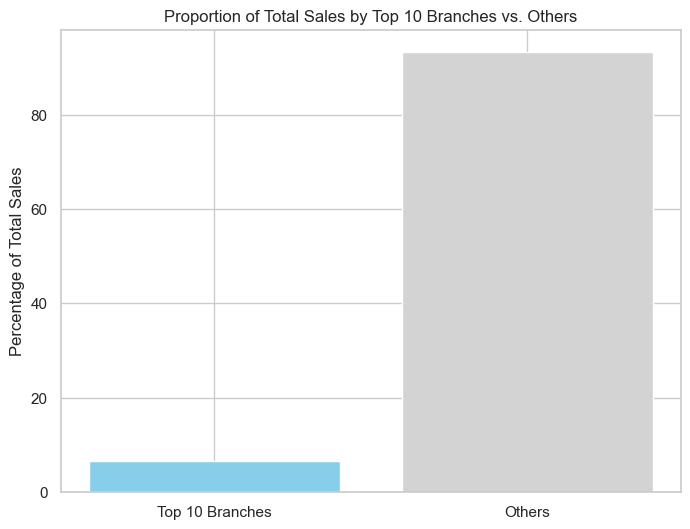

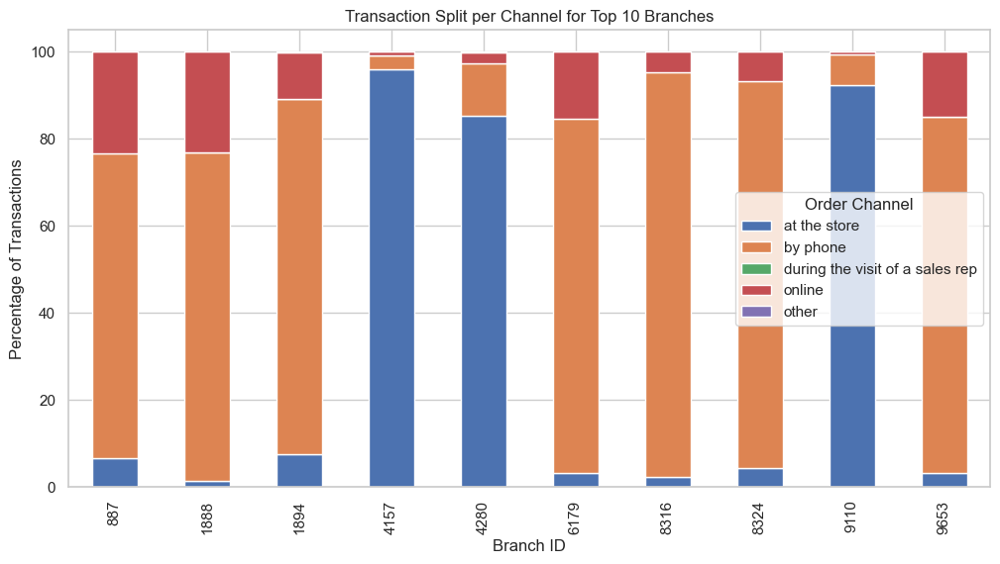

In [ ]:
# Proportion of Total Sales by Top 10 Branches
fig, ax = plt.subplots(figsize=(8, 6))
ax.bar(['Top 10 Branches', 'Others'], [proportion_of_sales_top_10, 100-proportion_of_sales_top_10], color=['skyblue', 'lightgrey'])
ax.set_ylabel('Percentage of Total Sales')
ax.set_title('Proportion of Total Sales by Top 10 Branches vs. Others')
plt.show()

# Split of Transactions per Channel for Top 10 Branches
transaction_split_percent.plot(kind='bar', stacked=True, figsize=(12, 6))
plt.ylabel('Percentage of Transactions')
plt.xlabel('Branch ID')
plt.title('Transaction Split per Channel for Top 10 Branches')
plt.legend(title='Order Channel')
plt.show()


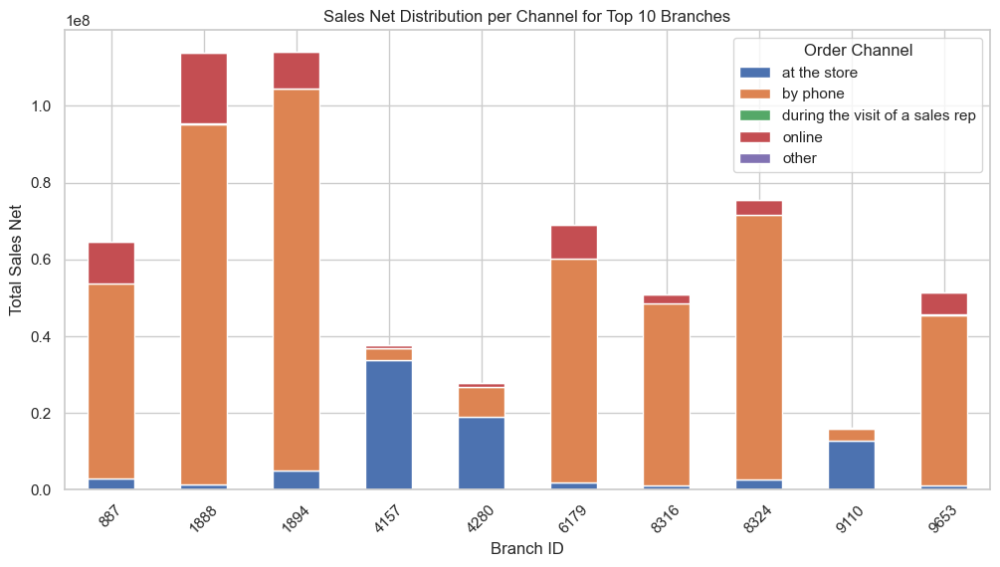

In [ ]:
# Step 1: Aggregate sales_net per order_channel for top 10 branches
top_10_branch_sales_channel = data_aggregated[data_aggregated['branch_id'].isin(top_10_branches_ids)].groupby(['branch_id', 'order_channel'])['sales_net'].sum().unstack(fill_value=0)

# Step 2: Plot the aggregated data
top_10_branch_sales_channel.plot(kind='bar', stacked=True, figsize=(12, 6))

plt.title('Sales Net Distribution per Channel for Top 10 Branches')
plt.xlabel('Branch ID')
plt.ylabel('Total Sales Net')
plt.legend(title='Order Channel')
plt.xticks(rotation=45)

plt.show()

# 5. RELATION BETWEEN PRODUCTS & BRANCHES

In [ ]:
correlation_matrix = branche_df[['unique_product_ids', 'unique_client_ids', 'total_sales_net']].corr()
print(correlation_matrix)

                    unique_product_ids  unique_client_ids  total_sales_net
unique_product_ids            1.000000            0.78641         0.930299
unique_client_ids             0.786410            1.00000         0.726880
total_sales_net               0.930299            0.72688         1.000000


**Comments:**    
- There is a high positive correlation between the number of unique products a branch offers (unique_product_ids) and the total sales net (total_sales_net) with a coefficient of approximately 0.93. This suggests that branches offering a wider variety of products tend to have higher sales.
- There is also a strong positive correlation of approximately 0.79 between the number of unique products and the number of unique clients (unique_client_ids), indicating that product diversity tends to attract more customers.
- The correlation between unique client counts and total sales net is also strong (approximately 0.73), indicating that branches with more customers tend to have higher sales.

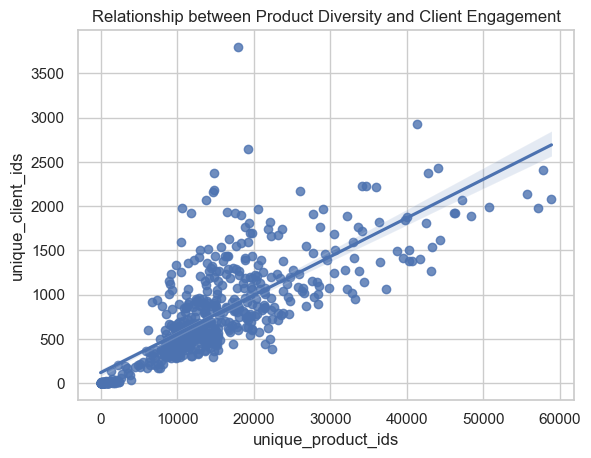

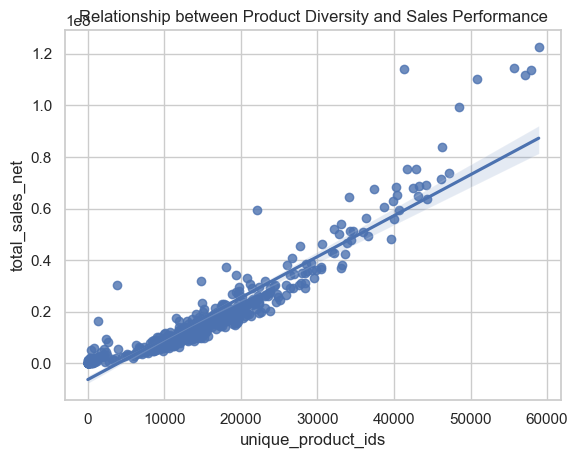

In [ ]:
# Scatter plot for unique_product_ids vs. unique_client_ids
sns.regplot(x='unique_product_ids', y='unique_client_ids', data=branche_df)
plt.title('Relationship between Product Diversity and Client Engagement')
plt.show()

# Scatter plot for unique_product_ids vs. total_sales_net
sns.regplot(x='unique_product_ids', y='total_sales_net', data=branche_df)
plt.title('Relationship between Product Diversity and Sales Performance')
plt.show()

In [ ]:
# Define bins for product diversity levels
bins = [0, branche_df['unique_product_ids'].quantile(0.33), branche_df['unique_product_ids'].quantile(0.66), float('inf')]
labels = ['Low Product Diversity', 'Medium Product Diversity', 'High Product Diversity']
branche_df['ProductDiversitySegment'] = pd.cut(branche_df['unique_product_ids'], bins=bins, labels=labels, include_lowest=True)

segment_analysis = branche_df.groupby('ProductDiversitySegment').agg({'unique_client_ids': 'mean', 'total_sales_net': 'mean'}).reset_index()
print(segment_analysis)

    ProductDiversitySegment  unique_client_ids  total_sales_net
0     Low Product Diversity         213.343750     3.566209e+06
1  Medium Product Diversity         734.390625     1.159263e+07
2    High Product Diversity        1241.813131     3.261143e+07


**Comment:**
The segmentation analysis categorizes branches into low, medium, and high product diversity segments. It clearly shows that branches in the high product diversity segment have significantly higher average client engagement and sales performance than those in the low and medium segments.

# 6. BASKET ANALYSIS:

In [ ]:
data_aggregated.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 63319315 entries, 0 to 63319314
Data columns (total 15 columns):
 #   Column             Dtype         
---  ------             -----         
 0   date_order         datetime64[ns]
 1   date_invoice       datetime64[ns]
 2   product_id         int32         
 3   client_id          int32         
 4   sales_net          float32       
 5   quantity           int32         
 6   order_channel      category      
 7   branch_id          int16         
 8   cluster            int16         
 9   lead_time          float32       
 10  price_category     category      
 11  quantity_category  category      
 12  Recency            int32         
 13  Frequency          int32         
 14  MonetaryValue      float32       
dtypes: category(3), datetime64[ns](2), float32(3), int16(2), int32(5)
memory usage: 3.2 GB


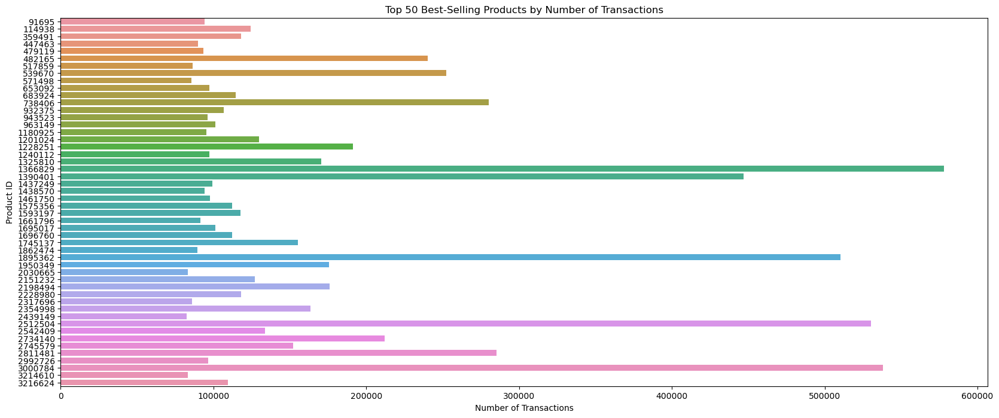

In [ ]:
# Step 1: Aggregate the number of transactions per product_id
product_transaction_counts = data_aggregated['product_id'].value_counts().reset_index()
product_transaction_counts.columns = ['product_id', 'transaction_count']

# Step 2: Sort the products by the number of transactions, descending
product_transaction_counts = product_transaction_counts.sort_values(by='transaction_count', ascending=False)

top_n = 50
plt.figure(figsize=(20, 8))
sns.barplot(x='transaction_count', y='product_id', data=product_transaction_counts.head(top_n), orient='h')
plt.title(f'Top {top_n} Best-Selling Products by Number of Transactions')
plt.xlabel('Number of Transactions')
plt.ylabel('Product ID')
plt.show()

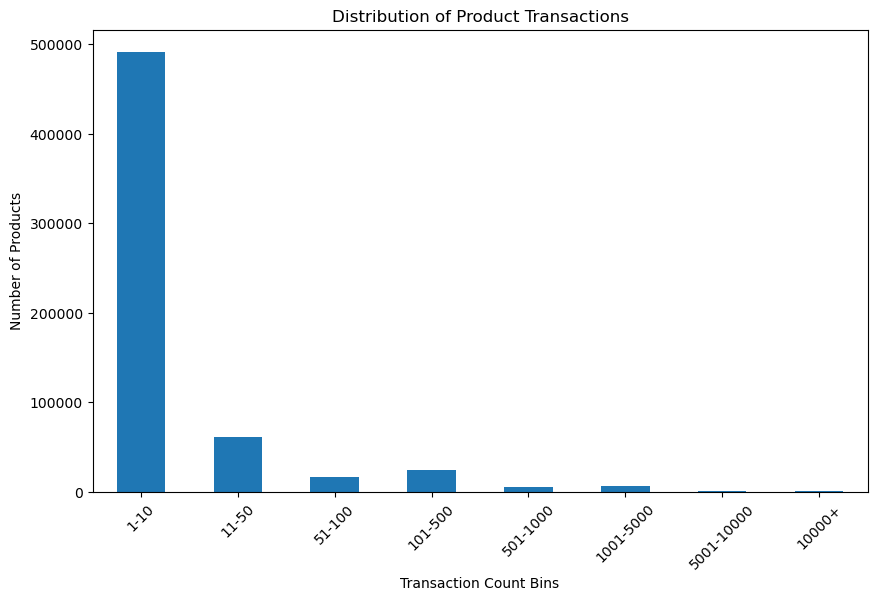

In [ ]:
# Step 1: Aggregate the number of transactions per product_id
product_transaction_counts = data_aggregated['product_id'].value_counts().reset_index()
product_transaction_counts.columns = ['product_id', 'transaction_count']

# Step 2: Create bins for the transaction count ranges
bins = [0, 10, 50, 100, 500, 1000, 5000, 10000, float('inf')]
labels = ['1-10', '11-50', '51-100', '101-500', '501-1000', '1001-5000', '5001-10000', '10000+']
product_transaction_counts['transaction_bin'] = pd.cut(product_transaction_counts['transaction_count'], bins=bins, labels=labels)

# Step 3: Calculate the count of products in each bin
bin_counts = product_transaction_counts['transaction_bin'].value_counts().sort_index()

plt.figure(figsize=(10, 6))
bin_counts.plot(kind='bar')
plt.title('Distribution of Product Transactions')
plt.xlabel('Transaction Count Bins')
plt.ylabel('Number of Products')
plt.xticks(rotation=45)
plt.show()

In [ ]:
data_aggregated

,date_order,date_invoice,product_id,client_id,sales_net,quantity,order_channel,branch_id,cluster,lead_time,price_category,quantity_category,Recency,Frequency,MonetaryValue
0,2017-09-25,2017-09-25,2376333,188502,155.443207,3,online,2732,3,0.0,average,important,678,616,6.670034e+04
1,2017-09-25,2017-09-25,2520527,835089,16.394400,3,at the store,10279,3,0.0,cheap,important,371,1745,2.916037e+05
2,2017-09-25,2017-09-25,2536756,1977896,365.766235,21,online,6184,3,0.0,cheap,important,982,517,1.453909e+05
3,2017-09-25,2017-09-25,3028673,598816,8.598780,201,at the store,4200,3,0.0,cheap,important,674,3275,2.226145e+05
4,2017-09-25,2017-09-25,203377,2086861,1093.374023,3,by phone,7051,3,0.0,expensive,important,671,325,4.033201e+04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
63319310,2019-06-10,2020-06-12,1596284,245272,-2056.913086,5,by phone,7682,2,368.0,expensive,important,366,22373,4.304535e+06
63319311,2018-12-14,2020-07-15,908253,880496,27.627600,1001,by phone,9375,3,579.0,cheap,important,364,65,4.707972e+04
63319312,2019-07-26,2020-10-29,1168247,2063314,-204.609833,101,by phone,3014,3,461.0,cheap,important,258,37,2.208957e+04
63319313,2018-05-23,2020-11-27,2319965,1287654,70.497299,17,by phone,1015,3,919.0,cheap,important,229,342,4.788407e+04


In [ ]:
# Filter dataset for products purchased 51-5000 times
product_counts = data_aggregated['product_id'].value_counts()
products_51_5000 = product_counts[(product_counts >= 51) & (product_counts <= 5000)].index

filtered_transactions = data_aggregated[data_aggregated['product_id'].isin(products_51_5000)]

In [ ]:
filtered_transactions.head()

,date_order,date_invoice,product_id,client_id,sales_net,quantity,order_channel,branch_id,cluster,lead_time,price_category,quantity_category,Recency,Frequency,MonetaryValue
4,2017-09-25,2017-09-25,203377,2086861,1093.374023,3,by phone,7051,3,0.0,expensive,important,671,325,40332.011719
5,2017-09-25,2017-09-25,793319,564878,116.703842,11,by phone,35,3,0.0,cheap,important,450,3140,317567.000000
6,2017-09-25,2017-09-25,745693,482822,1.449000,5,by phone,2771,3,0.0,cheap,important,666,180,16716.583984
12,2017-09-25,2017-09-25,1329933,234582,253.566727,11,online,7203,3,0.0,cheap,important,651,2725,351094.250000
19,2017-09-25,2017-09-25,966601,2258090,17.581200,3,at the store,2205,3,0.0,cheap,important,645,4399,323399.156250


In [ ]:
num_products = filtered_transactions['product_id'].nunique()
print(f"Number of unique products: {num_products}")

Number of unique products: 52859


In [ ]:
# Example: Focus on top 500 products
top_products = filtered_transactions['product_id'].value_counts().head(300).index
filtered_transactions_subset = filtered_transactions[filtered_transactions['product_id'].isin(top_products)]

In [ ]:
# One-hot encode the transactions
basket = (filtered_transactions_subset
          .groupby(['client_id', 'product_id'])['quantity']
          .sum().unstack(fill_value=0)
          .astype(pd.SparseDtype('int', fill_value=0)))

In [ ]:
basket.head()

product_id,1274,10318,10411,28769,51897,67220,80624,82464,82551,86153,...,3164761,3176903,3177159,3192350,3206055,3208918,3209669,3222054,3226398,3227007
client_id,,,,,,,,,,,,,,,,,,,,,
14,0,9,8,401,0,0,0,0,20,0,...,51,0,21,0,3,22,0,0,603,102
18,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
40,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
56,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
68,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
#because previous not working
def encode_units(x):
    """
    Encode the quantity of items in a transaction.

    Parameters:
    - x: The quantity of items in a transaction.

    Returns:
    - 0 if the quantity is 0, 1 otherwise.
    """
    if x <= 0:
        return 0
    if x >= 1:
        return 1


basket_sets = basket.copy()
for column in basket_sets.columns:
    basket_sets[column] = basket_sets[column].apply(encode_units)

In [ ]:
#This is the part that takes a lot of memory if too many products

# Convert column names to strings
basket_sets.columns = [str(i) for i in basket_sets.columns]

from mlxtend.frequent_patterns import apriori

min_support = 0.01
frequent_itemsets = apriori(basket_sets, min_support=min_support, use_colnames=True)

print(frequent_itemsets.head())

C:\Users\fanny\anaconda3\lib\site-packages\mlxtend\frequent_patterns\fpcommon.py:109: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(


    support itemsets
0  0.023085   (1274)
1  0.015000  (10318)
2  0.015758  (10411)
3  0.029470  (28769)
4  0.019914  (51897)


In [ ]:
from mlxtend.frequent_patterns import association_rules

# Generate association rules
rules = association_rules(frequent_itemsets, metric="lift", min_threshold=1)

print(rules.head(10))

  antecedents consequents  antecedent support  consequent support   support  \
0    (124206)   (1632436)            0.026981            0.031451  0.010357   
1   (1632436)    (124206)            0.031451            0.026981  0.010357   
2   (2541918)    (124206)            0.026331            0.026981  0.010649   
3    (124206)   (2541918)            0.026981            0.026331  0.010649   
4   (3014469)    (275763)            0.024849            0.025455  0.022078   
5    (275763)   (3014469)            0.025455            0.024849  0.022078   
6   (2070018)    (403382)            0.021948            0.023712  0.012230   
7    (403382)   (2070018)            0.023712            0.021948  0.012230   
8   (2805121)    (479270)            0.020195            0.018788  0.010552   
9    (479270)   (2805121)            0.018788            0.020195  0.010552   

   confidence       lift  leverage  conviction  zhangs_metric  
0    0.383875  12.205661  0.009509    1.572001       0.943528  
1 

- antecedents: The item(s) on the left-hand side of the rule. These are the items that the rule suggests are bought together with the items in the consequents.
- consequents: The item(s) on the right-hand side of the rule. These are the items that are suggested to be bought in conjunction with the antecedents.
- antecedent support: The proportion of transactions in the dataset that contain the antecedents. It reflects how frequently the antecedent set appears in the dataset.
- consequent support: The proportion of transactions in the dataset that contain the consequents. It reflects how frequently the consequent set appears in the dataset.
- support: The proportion of transactions in the dataset that contain both the antecedents and consequents. This measures how often the rule has been found to be true.
- confidence: The probability of seeing the consequents in transactions given that these transactions also contain the antecedents. It measures the reliability of the inference made by the rule.
- lift: The ratio of the observed support to that expected if the antecedents and consequents were independent. A lift value greater than 1 means that the antecedents and consequents appear more often together than expected, indicating a positive relationship between them.
- leverage: The difference between the observed support and the expected support if the antecedents and consequents were independent. Positive leverage indicates that the antecedents and consequents appear together more often than expected.
- conviction: A measure of the rule's robustness. It compares the probability of the antecedents appearing without the consequents if they were dependent with the actual observed frequency of the antecedents without the consequents. A higher conviction means the antecedents are more dependent on the consequents.
- zhangs_metric: A measure of the rule's certainty and directionality, ranging from -1 to 1. Values close to 1 or -1 indicate strong positive or negative rules, respectively.

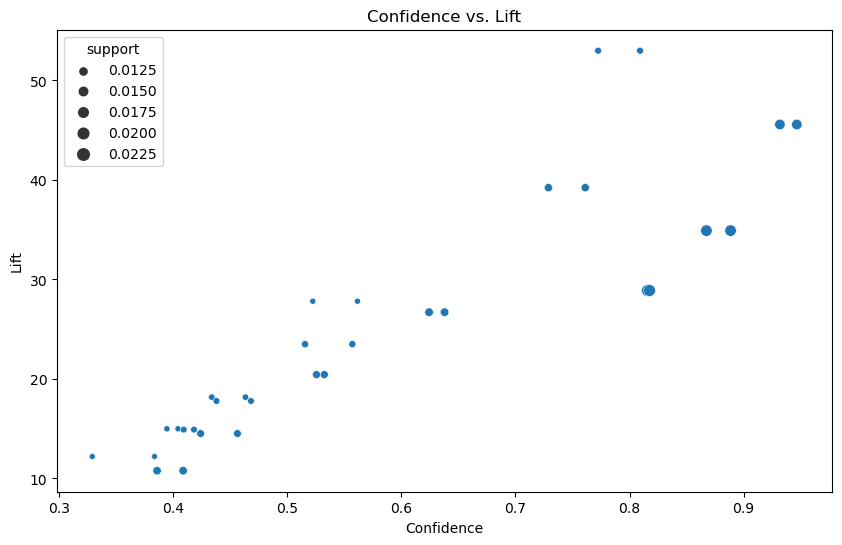

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10, 6))
sns.scatterplot(x="confidence", y="lift", size="support", data=rules)
plt.title('Confidence vs. Lift')
plt.xlabel('Confidence')
plt.ylabel('Lift')
plt.show()

**Comment:**                         
Looking at your scatter plot, here are some interpretations:
- The majority of the rules have a confidence between approximately 0.3 and 0.6. There are a few rules with very high confidence, close to 1.0, which means for these rules, the consequent is very likely to be purchased when the antecedent is purchased.
- The lift values for most rules seem to be above 10, with several rules having particularly high lift values (over 30). This suggests that many of the item combinations occur together more frequently than would be expected if they were independent. **Rules with the highest lift values may be particularly strong candidates for promotional strategies or product placement.**
- The support sizes vary, with a few rules having higher support (indicated by larger points), but most have relatively low support. This indicates that while some item combinations are common across the dataset, **many of the identified rules apply to a smaller segment of transactions.**

There are no rules in the top-left corner of the plot, which would indicate high lift but low confidence. It means there are no cases where item B is bought very often when A is bought, but A is not a good predictor of B on its own.

In [ ]:
# Filter the rules for those with a confidence greater than 0.7
high_confidence_rules = rules[rules['confidence'] > 0.7]
print(high_confidence_rules)

   antecedents consequents  antecedent support  consequent support   support  \
4      3014469      275763            0.024849            0.025455  0.022078   
5       275763     3014469            0.025455            0.024849  0.022078   
14     1014087     2328613            0.028301            0.028236  0.023085   
15     2328613     1014087            0.028236            0.028301  0.023085   
20     1594060     1460105            0.018582            0.019405  0.014145   
21     1460105     1594060            0.019405            0.018582  0.014145   
22     2092947     1618675            0.014578            0.015271  0.011797   
23     1618675     2092947            0.015271            0.014578  0.011797   
26     2460873     1812117            0.020444            0.020769  0.019351   
27     1812117     2460873            0.020769            0.020444  0.019351   

    confidence       lift  leverage  conviction  zhangs_metric  
4     0.888502  34.905048  0.021446    8.740452       

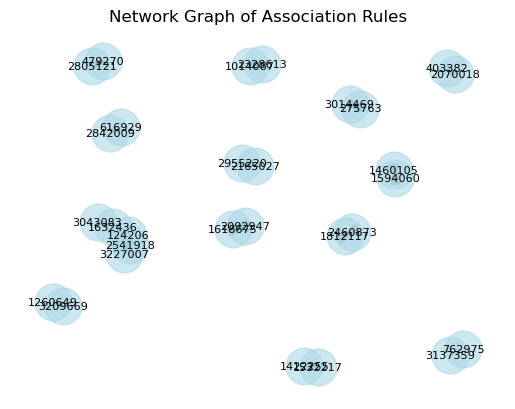

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt

G = nx.DiGraph()

for i, row in rules.iterrows():
    G.add_edge(row['antecedents'], row['consequents'], weight=row['lift'])

pos = nx.spring_layout(G, k=0.1, iterations=20)

nx.draw_networkx_nodes(G, pos, node_color='lightblue', alpha=0.6, node_size=700)
nx.draw_networkx_edges(G, pos, width=[G[u][v]['weight']/10 for u, v in G.edges()], alpha=0.7, edge_color='grey')
nx.draw_networkx_labels(G, pos, font_size=8)

plt.axis('off')
plt.title('Network Graph of Association Rules')

plt.show()

### Making sense of the rules - realting them to customers

In [ ]:
data_aggregated.head()

,date_order,date_invoice,product_id,client_id,sales_net,quantity,order_channel,branch_id,cluster,lead_time,price_category,quantity_category,Recency,Frequency,MonetaryValue
0,2017-09-25,2017-09-25,2376333,188502,155.443207,3,online,2732,3,0.0,average,important,678,616,66700.335938
1,2017-09-25,2017-09-25,2520527,835089,16.394400,3,at the store,10279,3,0.0,cheap,important,371,1745,291603.656250
2,2017-09-25,2017-09-25,2536756,1977896,365.766235,21,online,6184,3,0.0,cheap,important,982,517,145390.906250
3,2017-09-25,2017-09-25,3028673,598816,8.598780,201,at the store,4200,3,0.0,cheap,important,674,3275,222614.515625
4,2017-09-25,2017-09-25,203377,2086861,1093.374023,3,by phone,7051,3,0.0,expensive,important,671,325,40332.011719


In [ ]:
rfm_score.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170589 entries, 0 to 170588
Data columns (total 13 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   client_id       170589 non-null  int64  
 1   date_order_max  170589 non-null  object 
 2   Recency         170589 non-null  int64  
 3   T               170589 non-null  int64  
 4   MonetaryValue   170589 non-null  float64
 5   Frequency       170589 non-null  int64  
 6   RecencyScore    170589 non-null  int64  
 7   FrequencyScore  170589 non-null  int64  
 8   MonetaryScore   170589 non-null  int64  
 9   RFM_Segment     170589 non-null  int64  
 10  RFM_Score       170589 non-null  int64  
 11  RFM_Level       170589 non-null  object 
 12  Is_Churned      170589 non-null  bool   
dtypes: bool(1), float64(1), int64(9), object(2)
memory usage: 15.8+ MB


In [ ]:
import pandas as pd
from ast import literal_eval

rules['antecedents'] = rules['antecedents'].apply(lambda x: str(x).strip('()'))
rules['consequents'] = rules['consequents'].apply(lambda x: str(x).strip('()'))

# Extract unique product IDs from the rules
product_ids = set()
for index, row in rules.iterrows():
    antecedents = literal_eval(f"({row['antecedents']},)")
    consequents = literal_eval(f"({row['consequents']},)")

    product_ids.update(antecedents)
    product_ids.update(consequents)

product_ids

{124206,
 275763,
 403382,
 479270,
 616929,
 762975,
 1014087,
 1260649,
 1422255,
 1460105,
 1532217,
 1594060,
 1618675,
 1632436,
 1812117,
 2070018,
 2092947,
 2165027,
 2328613,
 2460873,
 2541918,
 2805121,
 2842009,
 2955220,
 3014469,
 3043083,
 3137359,
 3209669,
 3227007}

In [ ]:
product_ids_list = list(product_ids)

# Filter the product_transaction_counts DataFrame to include only the product IDs from the rules
filtered_product_transactions = product_transaction_counts[product_transaction_counts['product_id'].isin(product_ids_list)]
print(filtered_product_transactions)


      product_id  transaction_count transaction_bin
2032     2842009               4983       1001-5000
2051     1460105               4937       1001-5000
2064      762975               4904       1001-5000
2068     1532217               4884       1001-5000
2074     2805121               4873       1001-5000
2078      616929               4862       1001-5000
2088     1632436               4842       1001-5000
2104     3137359               4800       1001-5000
2118     1618675               4772       1001-5000
2140     2070018               4714       1001-5000
2145     2955220               4701       1001-5000
2148     2165027               4696       1001-5000
2151      403382               4684       1001-5000
2193      124206               4612       1001-5000
2207      275763               4570       1001-5000
2215     1422255               4552       1001-5000
2226     3043083               4530       1001-5000
2244     1594060               4497       1001-5000
2263     101

In [ ]:
# Filter transactions that include these product IDs
transactions_with_products = data_aggregated[data_aggregated['product_id'].isin(product_ids)]

# Link transactions to clients
clients_with_products = transactions_with_products[['client_id', 'product_id']]

# Merge client RFM and churn data
client_rfm_churn_data = rfm_score # Assume this is your DataFrame with RFM and churn data
merged_data = clients_with_products.merge(client_rfm_churn_data, on='client_id', how='left')

# Analyze the merged data
rfm_levels = merged_data.groupby(['client_id', 'RFM_Level'])['product_id'].count().reset_index(name='product_count')

print(rfm_levels)

       client_id           RFM_Level  product_count
0             14           Champions             16
1             18           Champions              1
2            252           Champions              5
3            259           Champions              1
4            280  Potential Loyalist              1
...          ...                 ...            ...
27678    2274272           Champions              5
27679    2274279      Need Attention              1
27680    2274294           Champions              2
27681    2274299           Champions              1
27682    2274517  Potential Loyalist              1

[27683 rows x 3 columns]


In [ ]:
# Group by product_id and RFM_Level
product_rfm_counts = merged_data.groupby(['product_id', 'RFM_Level']).size().reset_index(name='count')

# Sort the results to see the most common RFM Level for each product
product_rfm_counts = product_rfm_counts.sort_values(by=['product_id', 'count'], ascending=[True, False])

# Get the most common RFM Level for each product
most_common_rfm_per_product = product_rfm_counts.groupby('product_id').head(1)

print(most_common_rfm_per_product)

     product_id  RFM_Level  count
1        124206  Champions   4038
6        275763  Champions   4011
10       403382  Champions   4121
15       479270  Champions   4029
20       616929  Champions   4309
24       762975  Champions   3956
28      1014087  Champions   3814
33      1260649  Champions   3771
37      1422255  Champions   3767
42      1460105  Champions   4429
47      1532217  Champions   4112
52      1594060  Champions   4017
56      1618675  Champions   4354
61      1632436  Champions   4202
66      1812117  Champions   4144
70      2070018  Champions   4176
75      2092947  Champions   4024
80      2165027  Champions   4284
85      2328613  Champions   3745
90      2460873  Champions   4149
94      2541918  Champions   3966
99      2805121  Champions   4390
103     2842009  Champions   4520
107     2955220  Champions   4316
111     3014469  Champions   3933
115     3043083  Champions   3981
120     3137359  Champions   3969
125     3209669  Champions   3775
130     322700

In [ ]:
# Group by product_id and RFM_Level
product_rfm_counts = merged_data.groupby(['product_id', 'RFM_Level']).size().reset_index(name='count')

# Sort the results to see the most common RFM Level for each product
product_rfm_counts = product_rfm_counts.sort_values(by=['product_id', 'count'], ascending=[True, False])

# Get the most common RFM Level for each product
most_common_rfm_per_product = product_rfm_counts.groupby('product_id').tail(1)

print(most_common_rfm_per_product)

     product_id    RFM_Level  count
2        124206  Hibernating      2
5        275763      At Risk     16
11       403382  Hibernating      1
16       479270  Hibernating      1
19       616929      At Risk     17
23       762975      At Risk     42
29      1014087  Hibernating      5
32      1260649      At Risk     35
38      1422255  Hibernating      1
43      1460105  Hibernating      1
48      1532217  Hibernating      3
51      1594060      At Risk     14
57      1618675  Hibernating      1
62      1632436  Hibernating      5
65      1812117      At Risk      2
71      2070018  Hibernating      1
76      2092947  Hibernating      1
81      2165027  Hibernating      4
86      2328613  Hibernating      5
89      2460873      At Risk      3
95      2541918  Hibernating      2
98      2805121      At Risk     21
102     2842009      At Risk     14
106     2955220      At Risk     11
110     3014469      At Risk     13
116     3043083  Hibernating      1
121     3137359  Hibernating

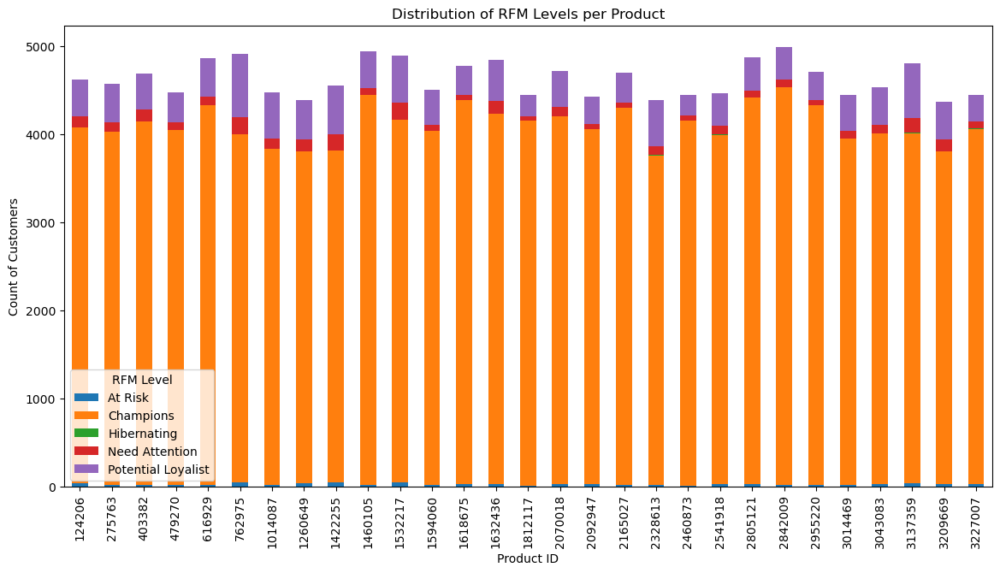

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

product_rfm_pivot = product_rfm_counts.pivot(index='product_id', columns='RFM_Level', values='count').fillna(0)

product_rfm_pivot.plot(kind='bar', stacked=True, figsize=(14, 7))

plt.title('Distribution of RFM Levels per Product')
plt.xlabel('Product ID')
plt.ylabel('Count of Customers')
plt.legend(title='RFM Level')
plt.show()

Let's try to understand from all these clients who supported the rule (and bought antecedents and consequent) and who just bought one of them

In [ ]:
antecedent_ids = set(rules['antecedents'].unique())
consequent_ids = set(rules['consequents'].unique())

In [ ]:
antecedent_ids = set(map(int, antecedent_ids))
consequent_ids = set(map(int, consequent_ids))

In [ ]:
transactions_with_antecedents = data_aggregated[data_aggregated['product_id'].isin(antecedent_ids)]
transactions_with_consequents = data_aggregated[data_aggregated['product_id'].isin(consequent_ids)]

In [ ]:
transactions_with_consequents

,date_order,date_invoice,product_id,client_id,sales_net,quantity,order_channel,branch_id,cluster,lead_time,price_category,quantity_category,Recency,Frequency,MonetaryValue


In [ ]:
data_aggregated.head()

,date_order,date_invoice,product_id,client_id,sales_net,quantity,order_channel,branch_id,cluster,lead_time,price_category,quantity_category,Recency,Frequency,MonetaryValue
0,2017-09-25,2017-09-25,2376333,188502,155.443207,3,online,2732,3,0.0,average,important,678,616,66700.335938
1,2017-09-25,2017-09-25,2520527,835089,16.394400,3,at the store,10279,3,0.0,cheap,important,371,1745,291603.656250
2,2017-09-25,2017-09-25,2536756,1977896,365.766235,21,online,6184,3,0.0,cheap,important,982,517,145390.906250
3,2017-09-25,2017-09-25,3028673,598816,8.598780,201,at the store,4200,3,0.0,cheap,important,674,3275,222614.515625
4,2017-09-25,2017-09-25,203377,2086861,1093.374023,3,by phone,7051,3,0.0,expensive,important,671,325,40332.011719


In [ ]:
# Clients who bought antecedents
clients_antecedents = set(transactions_with_antecedents['client_id'].unique())

# Clients who bought consequents
clients_consequents = set(transactions_with_consequents['client_id'].unique())

# Clients who bought both
clients_both = clients_antecedents.intersection(clients_consequents)

# Clients who bought only antecedents or only consequents
clients_antecedents_only = clients_antecedents - clients_consequents
clients_consequents_only = clients_consequents - clients_antecedents

total_clients = len(clients_antecedents.union(clients_consequents))

if total_clients > 0:
    percent_both = len(clients_both) / total_clients * 100
    percent_antecedents_only = len(clients_antecedents_only) / total_clients * 100
    percent_consequents_only = len(clients_consequents_only) / total_clients * 100
else:
    percent_both = percent_antecedents_only = percent_consequents_only = 0

print(f"Percent who bought both: {percent_both}%")
print(f"Percent who bought only antecedents: {percent_antecedents_only}%")
print(f"Percent who bought only consequents: {percent_consequents_only}%")

Percent who bought both: 100.0%
Percent who bought only antecedents: 0.0%
Percent who bought only consequents: 0.0%
